In [78]:
import pandas as pd
import matplotlib as plt
import plotly.express as px
%matplotlib inline

In [79]:
schema17 = pd.read_csv('raw_data/schemas/survey_results_schema_17.csv')
schema18 = pd.read_csv('raw_data/schemas/survey_results_schema_18.csv')
schema19 = pd.read_csv('raw_data/schemas/survey_results_schema_19.csv')
schema20 = pd.read_csv('raw_data/schemas/survey_results_schema_20.csv')
schema21 = pd.read_csv('raw_data/schemas/survey_results_schema_21.csv')

In [80]:
schema17.columns

Index(['Column', 'Question'], dtype='object')

In [81]:
schema17.columns= ['Column', 'QuestionText']

In [82]:
schema18.columns

Index(['Column', 'QuestionText'], dtype='object')

In [83]:
schema19.columns

Index(['Column', 'QuestionText'], dtype='object')

In [84]:
schema20.columns

Index(['Column', 'QuestionText'], dtype='object')

In [85]:
schema21.columns

Index(['qid', 'qname', 'question', 'force_resp', 'type', 'selector'], dtype='object')

In [86]:
schema21 = schema21[['qname','question']]
schema21.columns = ['Column', 'QuestionText']
schema21.head(10)

,Column,QuestionText
0,S0,"<div><span style=""font-size:19px;""><strong>Hel..."
1,MetaInfo,Browser Meta Info
2,S1,"<span style=""font-size:22px; font-family: aria..."
3,MainBranch,Which of the following options best describes ...
4,Employment,Which of the following best describes your cur...
5,Country,"Where do you live? <span style=""font-weight: b..."
6,US_State,<p>In which state or territory of the USA do y...
7,UK_Country,In which part of the United Kingdom do you liv...
8,S2,"<span style=""font-size:22px; font-family: aria..."
9,EdLevel,Which of the following best describes the high...


In [87]:
schema17['Year'] = 2017
schema18['Year'] = 2018
schema19['Year'] = 2019
schema20['Year'] = 2020
schema21['Year'] = 2021

In [88]:
schema21.head()

,Column,QuestionText,Year
0,S0,"<div><span style=""font-size:19px;""><strong>Hel...",2021
1,MetaInfo,Browser Meta Info,2021
2,S1,"<span style=""font-size:22px; font-family: aria...",2021
3,MainBranch,Which of the following options best describes ...,2021
4,Employment,Which of the following best describes your cur...,2021


In [89]:
print(schema19.shape)
print(schema20.shape)
print(schema21.shape)

(85, 3)
(61, 3)
(48, 3)


In [90]:
schemas = pd.concat([schema19,schema20,schema21])

In [91]:
schemas.shape

(194, 3)

In [92]:
df = schemas[schemas.duplicated(subset='Column', keep=False)].sort_values(by='Column')

In [93]:
dubbled_Cols = df.groupby('Column').count().reset_index()[df.groupby('Column').count().reset_index()['Year']>2]['Column']

In [94]:
schemas[schemas['Column'].isin(dubbled_Cols)].to_csv('schemas.csv')

In [95]:
dubbled_Cols

0              Age
1       Age1stCode
2         CompFreq
3        CompTotal
5          Country
10         DevType
11         EdLevel
12      Employment
13       Ethnicity
14          Gender
21      MainBranch
27           OpSys
28         OrgSize
33       SOAccount
34          SOComm
35      SOPartFreq
36     SOVisitFreq
37       Sexuality
38      SurveyEase
39    SurveyLength
40           Trans
44       YearsCode
45    YearsCodePro
Name: Column, dtype: object

In [96]:
survey19 = pd.read_csv('raw_data/data/survey_results_public_19.csv')
survey20 = pd.read_csv('raw_data/data/survey_results_public_20.csv')
survey21 = pd.read_csv('raw_data/data/survey_results_public_21.csv')

In [97]:
survey19 = survey19[dubbled_Cols]
survey20 = survey20[dubbled_Cols]
survey21 = survey21[dubbled_Cols]

In [98]:
survey19['Year'] = 2019
survey20['Year'] = 2020
survey21['Year'] = 2021

In [99]:
survey = pd.concat([survey19,survey20,survey21])

In [100]:
survey.groupby('Year').count()

,Age,Age1stCode,CompFreq,CompTotal,Country,DevType,EdLevel,Employment,Ethnicity,Gender,...,SOAccount,SOComm,SOPartFreq,SOVisitFreq,Sexuality,SurveyEase,SurveyLength,Trans,YearsCode,YearsCodePro
Year,,,,,,,,,,,,,,,,,,,,,
2019,79210,87634,63268,55945,88751,81335,86390,87181,76668,85406,...,87828,88131,74692,88263,76147,87081,86984,83607,87938,74331
2020,45446,57900,40069,34826,64072,49370,57431,63854,45948,50557,...,56805,56476,46792,56970,43992,51802,51701,49345,57684,46349
2021,82407,83243,52150,47183,83439,66484,83126,83323,79464,82286,...,82525,82319,67553,82413,73366,81948,81711,80678,81641,61216


In [101]:
survey.isnull().sum(axis=1).value_counts()

0     95075
1     37934
5     21741
2     20661
4     14392
3     11882
6     11517
7      4814
8      2919
9      2181
16     1983
12     1568
20     1449
10     1406
15     1177
19     1168
11     1148
14     1024
13     1020
17      724
18      388
22      350
21      215
23       47
dtype: int64

In [102]:
survey.shape

(236783, 24)

In [103]:
survey.columns

Index(['Age', 'Age1stCode', 'CompFreq', 'CompTotal', 'Country', 'DevType',
       'EdLevel', 'Employment', 'Ethnicity', 'Gender', 'MainBranch', 'OpSys',
       'OrgSize', 'SOAccount', 'SOComm', 'SOPartFreq', 'SOVisitFreq',
       'Sexuality', 'SurveyEase', 'SurveyLength', 'Trans', 'YearsCode',
       'YearsCodePro', 'Year'],
      dtype='object')

In [104]:
survey[['Age']].value_counts()<100

Age            
25-34 years old    False
18-24 years old    False
35-44 years old    False
25.0               False
28.0               False
                   ...  
19.5                True
37.3                True
16.9                True
15.5                True
17.3                True
Length: 153, dtype: bool

In [105]:
survey19['Age'].value_counts()

25.0    4669
24.0    4428
27.0    4418
26.0    4397
28.0    4387
        ... 
24.8       1
90.0       1
61.3       1
4.0        1
87.0       1
Name: Age, Length: 126, dtype: int64

In [106]:
survey21['Age'].value_counts()

25-34 years old       32568
18-24 years old       20993
35-44 years old       15183
45-54 years old        5472
Under 18 years old     5376
55-64 years old        1819
Prefer not to say       575
65 years or older       421
Name: Age, dtype: int64

In [107]:
survey21['Age'].astype("category")

0        25-34 years old
1        18-24 years old
2        18-24 years old
3        35-44 years old
4        25-34 years old
              ...       
83434    25-34 years old
83435    18-24 years old
83436    25-34 years old
83437    25-34 years old
83438    18-24 years old
Name: Age, Length: 83439, dtype: category
Categories (8, object): ['18-24 years old', '25-34 years old', '35-44 years old', '45-54 years old', '55-64 years old', '65 years or older', 'Prefer not to say', 'Under 18 years old']

In [108]:
ageCategories = ['18-24 years old', '25-34 years old', '35-44 years old', '45-54 years old', '55-64 years old', '65 years or older', 'Prefer not to say', 'Under 18 years old']

In [109]:
survey21['Age'].isnull().sum()

1032

In [110]:
survey21['Age'].value_counts(dropna=False)

25-34 years old       32568
18-24 years old       20993
35-44 years old       15183
45-54 years old        5472
Under 18 years old     5376
55-64 years old        1819
NaN                    1032
Prefer not to say       575
65 years or older       421
Name: Age, dtype: int64

In [111]:
def convertAgeInCategories(ages):
    convertedAges = list()
    ageCategories = [
        'Under 18 years old',
        '18-24 years old', 
        '25-34 years old', 
        '35-44 years old', 
        '45-54 years old', 
        '55-64 years old', 
        '65 years or older', 
        'Prefer not to say'
    ]
    for age in ages:
        if pd.isna(age):
            convertedAges.append(age)
        elif 0<=age<18:
            convertedAges.append('Under 18 years old')
        elif 18<=age<25:
            convertedAges.append('18-24 years old')
        elif 25<=age<35:
            convertedAges.append('25-34 years old')
        elif 35<=age<45:
            convertedAges.append('35-44 years old')
        elif 45<=age<55:
            convertedAges.append('45-54 years old')
        elif 55<=age<65:
            convertedAges.append('55-64 years old')
        elif 65<=age<95:
            convertedAges.append('65 years or older')
        elif 95<=age:
            convertedAges.append('Prefer not to say')    
        else:
            print(f'FAIL: {age}')
    return convertedAges

In [112]:
survey20['Age'] = convertAgeInCategories(survey20['Age'])
survey19['Age'] = convertAgeInCategories(survey19['Age'])


In [113]:
survey = pd.concat([survey19,survey20,survey21])

In [114]:
survey['Id']=range(0,survey.shape[0])
survey.isna().sum()

Age             29720
Age1stCode       8006
CompFreq        81296
CompTotal       98829
Country           521
DevType         39594
EdLevel          9836
Employment       2425
Ethnicity       34703
Gender          18534
MainBranch        851
OpSys            9410
OrgSize         59932
SOAccount        9625
SOComm           9857
SOPartFreq      47746
SOVisitFreq      9137
Sexuality       43278
SurveyEase      15952
SurveyLength    16387
Trans           23153
YearsCode        9520
YearsCodePro    54887
Year                0
Id                  0
dtype: int64

In [115]:
ages = survey.groupby(['Year','Age']).count()[['Id']]/survey.shape[0]
ages = ages.reset_index()

In [116]:

ages

,Year,Age,Id
0,2019,18-24 years old,0.082041
1,2019,25-34 years old,0.156890
2,2019,35-44 years old,0.060625
3,2019,45-54 years old,0.018071
4,2019,55-64 years old,0.006031
5,2019,65 years or older,0.001461
6,2019,Prefer not to say,0.000118
7,2019,Under 18 years old,0.009287
8,2020,18-24 years old,0.045071
9,2020,25-34 years old,0.088119


In [117]:

fig = px.bar(ages, x="Age", y="Id", color="Year", title="Long-Form Input")
fig.show()

In [67]:
list(ages['Age'].unique())

['18-24 years old',
 '25-34 years old',
 '35-44 years old',
 '45-54 years old',
 '55-64 years old',
 '65 years or older',
 'Prefer not to say',
 'Under 18 years old']

In [68]:
ages = ages.pivot(columns=['Age'], index='Year').fillna(0).reset_index()

In [69]:
ages.columns = [('Year',                   'Year'),
            (  'Id',    '18-24 years old'),
            (  'Id',    '25-34 years old'),
            (  'Id',    '35-44 years old'),
            (  'Id',    '45-54 years old'),
            (  'Id',    '55-64 years old'),
            (  'Id',  '65 years or older'),
            (  'Id',  'Prefer not to say'),
            (  'Id', 'Under 18 years old')]

In [70]:
ages.columns = ['Year', 
        '18-24 years old',
        '25-34 years old', 
        '35-44 years old',
        '45-54 years old',
        '55-64 years old',
        '65 years or older',
        'Prefer not to say',
        'Under 18 years old']

In [71]:
ages

,Year,18-24 years old,25-34 years old,35-44 years old,45-54 years old,55-64 years old,65 years or older,Prefer not to say,Under 18 years old
0,2019,0.082041,0.156890,0.060625,0.018071,0.006031,0.001461,0.000118,0.009287
1,2020,0.045071,0.088119,0.036628,0.011855,0.004042,0.001085,0.000063,0.005068
2,2021,0.088659,0.137544,0.064122,0.023110,0.007682,0.001778,0.002428,0.022704


In [75]:
fig = px.bar(ages, x="Year", y=['18-24 years old',
        '25-34 years old', 
        '35-44 years old',
        '45-54 years old',
        '55-64 years old',
        '65 years or older',
        'Prefer not to say',
        'Under 18 years old'])
fig.update_layout(
    title="Survey Participants Per Age Group Of Each Year",
    title_x=0.5,
    xaxis_title="Year",
    yaxis_title="Fequencies of Ages",
    legend_title="Age Group",
    yaxis_tickformat = ',.0%'
)
fig.show()

In [118]:
survey.columns

Index(['Age', 'Age1stCode', 'CompFreq', 'CompTotal', 'Country', 'DevType',
       'EdLevel', 'Employment', 'Ethnicity', 'Gender', 'MainBranch', 'OpSys',
       'OrgSize', 'SOAccount', 'SOComm', 'SOPartFreq', 'SOVisitFreq',
       'Sexuality', 'SurveyEase', 'SurveyLength', 'Trans', 'YearsCode',
       'YearsCodePro', 'Year', 'Id'],
      dtype='object')

In [122]:
survey['CompTotal'].

100000.0    3077
60000.0     2856
50000.0     2786
80000.0     2517
120000.0    2467
            ... 
126729.0       1
90600.0        1
29214.0        1
7293.0         1
333000.0       1
Name: CompTotal, Length: 7562, dtype: int64

In [133]:
fig = px.histogram(survey, x="CompTotal", nbins=50)

In [134]:
fig.show()

In [132]:
survey["CompTotal"]

0             NaN
1             NaN
2         23000.0
3         61000.0
4             NaN
           ...   
83434    160500.0
83435    200000.0
83436      1800.0
83437     90000.0
83438      7700.0
Name: CompTotal, Length: 236783, dtype: float64

In [135]:
import seaborn as sns

C:\Users\FabianRoth\anaconda3\envs\udacity3.9\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='CompTotal', ylabel='Density'>

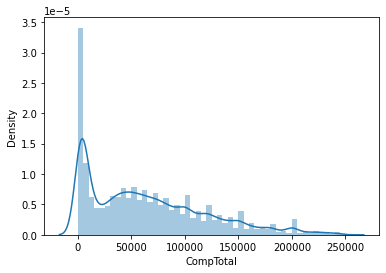

In [156]:
sns.distplot(survey[survey["CompTotal"]<250000].dropna()["CompTotal"])

In [141]:
list(survey["CompTotal"].dropna())

[23000.0,
 61000.0,
 40000.0,
 138000.0,
 950000.0,
 90000.0,
 4150.0,
 29000.0,
 90000.0,
 120000.0,
 9500.0,
 3000.0,
 103000.0,
 69000.0,
 8000.0,
 7000.0,
 114000.0,
 2000.0,
 90000.0,
 22000.0,
 700.0,
 80000.0,
 1500.0,
 96000.0,
 156000.0,
 18000.0,
 6400.0,
 175000.0,
 187000.0,
 5000.0,
 400000.0,
 12320.0,
 47300.0,
 51500.0,
 345000.0,
 85000.0,
 113000.0,
 2000.0,
 107000.0,
 66000.0,
 76800.0,
 28000.0,
 120000.0,
 50000.0,
 800000.0,
 1600.0,
 75000.0,
 18000.0,
 160000.0,
 100000.0,
 1250000.0,
 30000.0,
 100000.0,
 550000.0,
 110000.0,
 700000.0,
 40000.0,
 46000.0,
 9000.0,
 11000.0,
 100000.0,
 50000.0,
 2200.0,
 33000.0,
 110000.0,
 66750.0,
 300000.0,
 67800.0,
 155000.0,
 45000.0,
 160000.0,
 140000.0,
 25000.0,
 100000.0,
 300000.0,
 70000.0,
 30000.0,
 90000.0,
 26000.0,
 31000.0,
 24000.0,
 2800.0,
 8000.0,
 650000.0,
 3400.0,
 60000.0,
 106000.0,
 106000.0,
 62000.0,
 4000.0,
 5500.0,
 83200.0,
 55000.0,
 175600.0,
 57500.0,
 70000.0,
 540000.0,
 180000.0,
 820

<AxesSubplot:>

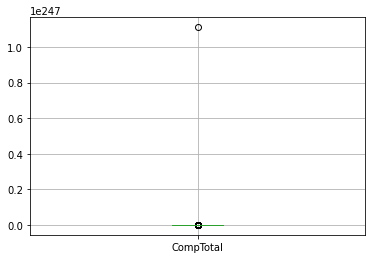

In [148]:
survey[["CompTotal"]].dropna().boxplot(column= "CompTotal")

In [149]:
survey[["CompTotal"]].dropna().max()

CompTotal    1.111111e+247
dtype: float64

<AxesSubplot:>

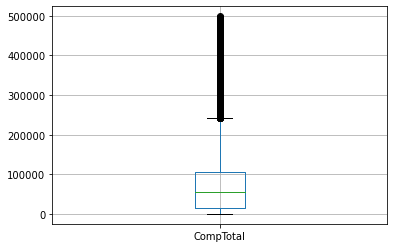

In [153]:
survey[survey["CompTotal"]<500000].dropna().boxplot(column= "CompTotal")

In [163]:
survey.columns

Index(['Age', 'Age1stCode', 'CompFreq', 'CompTotal', 'Country', 'DevType',
       'EdLevel', 'Employment', 'Ethnicity', 'Gender', 'MainBranch', 'OpSys',
       'OrgSize', 'SOAccount', 'SOComm', 'SOPartFreq', 'SOVisitFreq',
       'Sexuality', 'SurveyEase', 'SurveyLength', 'Trans', 'YearsCode',
       'YearsCodePro', 'Year', 'Id'],
      dtype='object')

In [165]:
survey['Country'].value_counts()

United States               33418
India                       27975
Germany                     15381
United States of America    15288
United Kingdom               9633
                            ...  
Grenada                         1
Sao Tome and Principe           1
Marshall Islands                1
Tonga                           1
Tuvalu                          1
Name: Country, Length: 198, dtype: int64

In [179]:
survey['SOPartFreq'].value_counts()

Less than once per month or monthly                   81650
I have never participated in Q&A on Stack Overflow    41957
A few times per month or weekly                       35389
A few times per week                                  16920
Daily or almost daily                                  8506
Multiple times per day                                 4615
Name: SOPartFreq, dtype: int64

In [167]:
devTypes = list()
for x in survey['DevType']:
    if pd.isna(x):
        pass
    else:
        

nan
Developer, desktop or enterprise applications;Developer, front-end
Designer;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Academic researcher;Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Engineer, data
Designer;Developer, front-end
Developer, back-end;Engineer, site reliability
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Educator
nan
Data or business analyst;Data scientist or machine learning specialist;Engineer, data;Student
Data or business analyst;Database administrator;Developer, back-end;Developer, 

Developer, embedded applications or devices;Developer, game or graphics
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;System administrator
Database administrator;Designer;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;System administrator
Developer, full-stack;Educator
nan
Academic researcher;Developer, back-end;Developer, desktop or enterprise applications;Developer, mobile;Student
Developer, QA or test
Developer, full-stack
Developer, back-end
Data or business analyst;Developer, back-end;Marketing or sales professional;Student
Developer, back-end;Developer, full-stack
Developer, full-stack
Database administrator;Developer, back-end
nan
Developer, front-end;Developer, mobile
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, data
Developer, m

Developer, mobile
Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;System administrator
Developer, front-end;Educator
Developer, mobile;Engineering manager
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Designer;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Academic researcher;Developer, back-end;Developer, front-end;Developer, full-stack;Scientist
Academic researcher;Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Educator;Product manager;Scientist;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Engineer, data
Developer, back-end;Developer, front-

Data or business analyst;Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;DevOps specialist
DevOps specialist
Developer, back-end
Developer, back-end
Database administrator;Developer, full-stack;Developer, mobile;System administrator
System administrator
Senior executive/VP
Developer, full-stack
Developer, mobile
Academic researcher;Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Student
Developer, full-stack
Developer, front-end
Academic researcher;Data scientist or machine learning specialist;Developer, full-stack;Scientist
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, mobile
Engineering manager
Developer, desktop or enterprise applications;DevOps specialist
Ac

Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack;Engineering manager
Developer, embedded applications or devices
Academic researcher;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;Engineering manager;Marketing or sales professional;Product manager;Scientist;Senior executive/VP
Developer, front-end
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;DevOps specialist;Engineer, data;Engineer, site reliability;Engineering manager;System admin

Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Student
Database administrator;Designer;Developer, back-end;Developer, full-stack
Developer, embedded applications or devices
Developer, full-stack
Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;DevOps specialist;Student;System administrator
nan
Developer, front-end;Educator;Product manager
nan
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile;DevOps specialist;Engineer, data;Engineer, site reliability;System administrator
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Academ

Developer, back-end;Developer, front-end;Developer, full-stack
Academic researcher;Designer;Developer, back-end;Developer, full-stack;Developer, mobile;Student
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;Engineer, site reliability
Academic researcher;Student
Designer;Developer, back-end;Developer, full-stack;Developer, QA or test
Developer, full-stack;Educator
Academic researcher;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Student
Developer, mobile
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Engineer, data
Developer, full-stack
Developer, front-end
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Devel

Developer, desktop or enterprise applications
Developer, back-end
nan
Developer, full-stack
Educator
Academic researcher;Developer, game or graphics;Scientist;Student
Developer, front-end
Data scientist or machine learning specialist;Developer, back-end;Developer, front-end;Developer, full-stack;Student
Developer, back-end;Developer, mobile;Student
Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile
Academic researcher;Developer, full-stack;Educator;Scientist;Student;System administrator
nan
Student
Student
Developer, full-stack
Developer, full-stack
Designer;Developer, desktop or enterprise applications;Developer, full-stack;Student
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, full-stack;Developer, mobile
Designer;Developer, back-end;Developer, embedded applications or 

Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, QA or test
nan
DevOps specialist;Engineer, site reliability;System administrator
Academic researcher;Developer, embedded applications or devices;Developer, front-end;Student
Developer, back-end;Student
Developer, full-stack;DevOps specialist
Developer, full-stack
Developer, embedded applications or devices
Academic researcher;Scientist
Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications;Engineer, site reliability
Data or business analyst;Designer;Developer, front-end;Developer, mobile;Product manager
Data or business analyst;Data scientist or machine learning specialist;Designer;Engineer, data;Scientist;Student
Developer, back-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack;Developer, QA or test
Developer, back-end
Developer, full-stack

Developer, full-stack;Senior executive/VP;Student
Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Engineering manager
Data or business analyst;Data scientist or machine learning specialist;Developer, embedded applications or devices;Engineering manager;Product manager;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics
Data or business analyst;Data scientist or machine learning specialist;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, mobile
Developer, mobile;Student
Academic researcher;Developer, desktop or enterprise applications;Developer, fu

Academic researcher;Developer, full-stack;Student
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Database administrator;Developer, desktop or enterprise applications;Developer, game or graphics;Developer, mobile;Engineer, data;Product manager;Student
Developer, mobile;Educator
nan
Data scientist or machine learning specialist;Developer, back-end;Engineer, data
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Database administrator;Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist;Product manager
Database administrator;Designer;Developer, embedded applications or devices;Developer, full-stack;Developer, game or graphics;Educator;System administrator
Developer, back-end;Developer, full-stack;DevOps specialist
Academic researcher;Developer, game or graphics;Developer, mobile
Developer, b

Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Student
Developer, QA or test
Developer, back-end
Developer, mobile
nan
Academic researcher;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, mobile;Educator;Engineer, data;Scientist
Developer, full-stack
Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Student
Database administrator;Developer, full-stack;Senior executive/VP
Developer, front-end
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Educator;Engineer, data;Engineer, site reliability;Engineering manager;Product manager;System administrator
Developer, full-stack
Data or business analyst;Database administrator;Developer, back-end;Develop

Student
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack
nan
Developer, full-stack;Educator
Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;DevOps specialist;Engineering manager
Developer, back-end;DevOps specialist;Product manager;System administrator
Academic researcher;Developer, full-stack;Engineer, data;Scientist;Student
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, front-end
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, mobile;Scientist
Developer, full-stack
Developer, back-end;Developer

Data or business analyst;Designer;Developer, front-end;Marketing or sales professional;Product manager;Scientist
Developer, back-end
Developer, full-stack
nan
Developer, full-stack
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist;Engineering manager
Data or business analyst;Developer, mobile;Engineer, data
Developer, back-end;Developer, full-stack;DevOps specialist;Engineer, site reliability;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile;Engineer, data;Engineering manager
Academic researcher;Data scientist or machine learning specialist;Developer, full-stack
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile
Data or business analyst;Developer, full-s

Developer, front-end;Developer, full-stack
Database administrator;Developer, full-stack;Engineering manager;System administrator
Data or business analyst;Designer;Developer, full-stack;Product manager;System administrator
Academic researcher;Database administrator;Developer, back-end;Developer, front-end;Student
DevOps specialist;Engineering manager;Product manager
Developer, full-stack
Data scientist or machine learning specialist;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Scientist
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;Product manager;System administrator
Developer, back-end;Developer, full-stack;Developer, mob

Developer, back-end;Developer, full-stack
Developer, front-end;Developer, full-stack
Developer, mobile
nan
Data or business analyst;Developer, full-stack;Developer, QA or test;Product manager
Developer, full-stack;Developer, game or graphics;Developer, mobile;Product manager
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Data or business analyst;Marketing or sales professional
Developer, desktop or enterprise applications;Developer, full-stack;Student
Developer, back-end
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data
Database administrator;Developer, back-end;DevOps specialist;System administrator
Developer, front-end;Senior executive/VP
Developer, back-end;Developer, deskt

Data or business analyst;Developer, desktop or enterprise applications
Developer, back-end
Developer, full-stack
Developer, full-stack
Academic researcher;Developer, back-end;Developer, front-end;Developer, full-stack;Educator
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
Database administrator;Developer, back-end;Developer, game or graphics;DevOps specialist;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Developer, back-end;Developer, full-stack;Student
Senior executive/VP
Product manager
Developer, full-stack;Marketing or sales professional
Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, fu

Developer, full-stack
nan
Developer, back-end;Product manager
Developer, full-stack;DevOps specialist
Data scientist or machine learning specialist;Engineer, data;Scientist
Developer, back-end;Developer, full-stack
Data scientist or machine learning specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, QA or test;System administrator
Developer, back-end
Designer;Developer, desktop or enterprise applications;Developer, front-end;Educator;Student;System administrator
Developer, back-end;Developer, full-stack;Student
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, front-end
Developer, mobile
Academic researcher;Scientist
Developer, full-stack
Developer, back-end;Developer, front-end
Developer, back-end;Developer, full-stack
Database administrator
Developer, desktop or enterprise applications
Data or business analyst
Student
Data or business ana

nan
Developer, front-end;Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Developer, game or graphics;Developer, mobile;Educator;Student;System administrator
Data scientist or machine learning specialist
Academic researcher;Developer, full-stack
Designer;Developer, front-end;Developer, full-stack
Developer, back-end
Designer;Developer, desktop or enterprise applications;Developer, front-end
Developer, front-end;Developer, full-stack
Academic researcher;Data or business analyst;Developer, back-end;Developer, QA or test;Engineer, site reliability
nan
Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Educator;Engineer, site reliability;Engineering manager;Product manager
Developer, back-end;Engineer, data
Data scientist or machine learning specialist;Engineer, data;Scientist
Developer, full-stack
Developer, front-end;Developer, full-stack
Data s

Academic researcher;Designer;Developer, mobile;Scientist;Senior executive/VP
Developer, full-stack
Developer, full-stack
Developer, full-stack
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;System administrator
Developer, full-stack;Developer, mobile
Developer, back-end;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;DevOps specialist
Developer, full-stack;Educator;Marketing or sales professional;Product manager
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Engineer, data
Developer, back-end;DevOps specialist;Engineer, site reliability
Developer, full-stack
Developer, full-stack
Developer, embedded applications or devi

Academic researcher;Developer, full-stack;System administrator
Designer;Developer, mobile
Database administrator;Designer;Developer, front-end;Developer, full-stack;System administrator
Scientist
Developer, mobile
Developer, front-end;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, QA or test;Scientist
Academic researcher;Data scientist or machine learning specialist;Scientist;Student
Developer, full-stack
nan
Designer;Developer, back-end;Developer, embedded applications or devices
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Senior executive/VP;System administrator
Developer, full-stack
Academic researcher;Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;Product manager;Senior executive/VP

Developer, back-end;Developer, embedded applications or devices;Developer, QA or test;Engineering manager
Developer, front-end
Developer, back-end;Developer, desktop or enterprise applications;Student
Developer, back-end;Developer, full-stack
Developer, mobile
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications
Designer;Developer, full-stack;Student
Developer, front-end;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack
Academic researcher;Developer, front-end;Developer, full-stack;Developer, mobile;Educator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
nan
Academic researcher;Data scientist or machine learning specialist;Scientist
Engineer, data
Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-sta

Developer, back-end;Engineer, data;Product manager
Student
Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, site reliability;Product manager;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end
Developer, back-end;Developer, embedded applications or devices;Developer, full-stack
Academic researcher;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, mobile;Developer, QA or test;Product manager
Developer, back-end;Developer, front-end;Developer, full-stack
Engineer, data
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, game or graphics;Developer, mobile;Student
Developer, back-end
Developer, back-end
Developer, full-stack
Developer, back-end
Developer,

Designer;Developer, back-end;Developer, desktop or enterprise applications
Developer, front-end
Developer, back-end
DevOps specialist
Designer;Developer, full-stack;Developer, game or graphics
Academic researcher;Data scientist or machine learning specialist;Scientist
nan
Developer, full-stack
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist
nan
Developer, mobile
Developer, back-end;Developer, full-stack;DevOps specialist
Developer, desktop or enterprise applications;Developer, full-stack;Developer, QA or test
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, embedded applications or devices
Developer, front-e

Developer, mobile
Developer, back-end
Developer, back-end;Developer, full-stack;DevOps specialist
Developer, back-end;Developer, full-stack;DevOps specialist
Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Engineer, data
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;Engineering manager;System administrator
Developer, full-stack
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, mobile
Data or business analyst
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Student
Developer, back-end;Developer, desktop or enterprise applications
Database administrator;Designer;Engineer, site reliability
Developer, back-end;Developer, full-stack
DevOps specialist;Engineer, site reliability;System administrator
Data or business analyst;Developer, bac

Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile;DevOps specialist;Engineer, data;Engineer, site reliability
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;Product manager;System administrator
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, full-stack
Developer, full-stack
Data scientist or machin

Designer;Developer, full-stack;Engineering manager;Product manager
Database administrator;Developer, back-end;Developer, full-stack;DevOps specialist
Database administrator;Developer, back-end;Developer, full-stack;Developer, QA or test;DevOps specialist;Engineer, site reliability;Engineering manager
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;System administrator
Developer, back-end;Developer, QA or test;Engineering manager
Developer, back-end
Academic researcher;Data or business analyst;Data scientist or machine learning specialist
Developer, back-end
Academic researcher;Scientist
Developer, back-end
Developer, back-end;Developer, front-end
Developer, back-end;Developer, full-stack
Developer, back-end
Developer, desktop or enterprise applications;Developer, mobile
nan
Data scientist or machine learnin

Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, QA or test;Educator;Engineer, data;Product manager;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Student;System administrator
Developer, front-end
Developer, desktop or enterprise applications;Developer, front-end;Engineer, data;Scientist
Developer, front-end
Developer, desktop or enterprise applications;Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end;Engineer, data;Scientist;Student;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, desktop or

nan
Designer;Developer, front-end
Developer, full-stack;Developer, game or graphics;Educator
Developer, desktop or enterprise applications
Designer;Developer, back-end;Developer, front-end
Developer, mobile;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;System administrator
Database administrator;Developer, back-end;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;Product manager
Data or business analyst;Database administrator
Data or business analyst
DevOps specialist
Developer, back-end;Developer, mobile
Developer, full-stack
Developer, full-stack;Developer, mobile
Academic researcher;Database administrator;Designer;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Educator;Product manager;System admin

Developer, front-end
Developer, front-end
nan
Developer, back-end;Engineer, data;Engineering manager
Data or business analyst;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, mobile
System administrator
Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
nan
Data or business analyst;Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications
nan
Designer;Developer, back-end;Developer, mobile;Developer, QA or test
Data or business analyst;Developer, full-stack;Product manager;Student
Developer, full-stack;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, mobile
Developer, 

Developer, front-end;Developer, full-stack;Developer, mobile
nan
nan
Developer, full-stack;Marketing or sales professional
DevOps specialist;System administrator
Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack
Developer, QA or test
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;Product manager;Scientist
Developer, back-end;Developer, full-stack;DevOps specialist
Academic researcher;Developer, full-stack;Developer, QA or test
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Scientist
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, 

Developer, full-stack
Data or business analyst;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Product manager
Developer, front-end
Academic researcher;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile;Educator
Student
Developer, back-end;Educator;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Data or business analyst
Developer, back-end;Student
Developer, front-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices
Academic researcher;Data scientist or machine learning specialist;Developer, back-end
Designer;Developer, back-end;Developer, front-end;Engineer, data
System administrator
Developer, back-end;Developer, QA or test;DevOps specialist
Developer, full-stack;Educator
Student
Developer,

Developer, mobile
Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Educator
Developer, back-end
Developer, front-end
Data or business analyst;Designer;Developer, desktop or enterprise applications;Developer, front-end;Engineer, data;Product manager
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Scientist;Student
Developer, full-stack;Engineer, data
Developer, back-end;Developer, front-end;Developer, full-stack;System administrator
Developer, back-end
Developer, back-end;Developer, full-stack
Developer, full-stack
nan
Developer, embedded applications or devices;Developer, full-stack;Educator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, QA or test
Developer, embedded applications or devices
Developer, embedded applications or devices;Developer, mobile
Developer, back-end;Developer, front-end
Developer, full-stack;Developer, mobile;De

Developer, full-stack
nan
Developer, back-end;Developer, front-end;Developer, mobile;Student;System administrator
Developer, front-end
Developer, back-end;DevOps specialist
Academic researcher;Developer, back-end;Developer, full-stack;Developer, mobile
Database administrator;Developer, full-stack;Developer, mobile
Developer, embedded applications or devices
Data scientist or machine learning specialist;Developer, back-end;Developer, full-stack;Developer, mobile;Product manager
Academic researcher;Developer, embedded applications or devices;Student
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;System administrator
Designer;Developer, front-end
Academic researcher;Data scientist or machine learning specialist;Developer, back-end;Educator;Engineer, data;Scientist
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-s

Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, back-end;Developer, front-end;Developer, full-stack;Student
Data or business analyst;Data scientist or machine learning specialist;Designer;Developer, back-end;Developer, front-end;Developer, QA or test
Developer, back-end;Developer, front-end;Developer, full-stack
Engineer, data;Engineer, site reliability;Student;System administrator
Designer;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end
Developer, full-stack
Developer, full-stack
Developer, back-end
Designer;Developer, front-end
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
nan
Database ad

Developer, back-end
Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications
Developer, front-end;Student
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, embedded applications or devices;Developer, front-end;Engineering manager
nan
Academic researcher;Developer, desktop or enterprise applications;Developer, front-end;Educator
Developer, back-end
Student
nan
Data scientist or machine learning specialist
Developer, embedded applications or devices;Developer, mobile
Data scientist or machine learning specialist;Scientist;Student
nan
Scientist
nan
Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or 

Developer, desktop or enterprise applications
Developer, front-end;Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Developer, mobile;Student
nan
Developer, full-stack
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;System administrator
Developer, full-stack
Academic researcher;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;DevOps specialist;Educator;Engineering manager;Product manager
Developer, back-end;Developer, full-stack
Data scientist or machine learning specialist;Engineer, data
Developer, embedded applications or devices;Developer, full-stack;Product manager
Academic researcher
Developer, embedded applications or devices

Developer, front-end
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, back-end
Developer, back-end;Developer, full-stack;Educator
Developer, embedded applications or devices;DevOps specialist
Developer, full-stack;DevOps specialist
System administrator
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, embedded applications or devices
Developer, front-end
Academic researcher;Developer, game or graphics;Educator;Engineer, data;System administrator
Designer;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, full-stack;DevOps specialist;Engineer, site reliability
Academic researcher;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, mobile;Senior executive/VP
Designer;Developer, back-end;Developer, game or graphics
Developer, back-end
Develop

Developer, back-end;Developer, desktop or enterprise applications
Developer, full-stack;Student
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Developer, QA or test
Engineer, data;Student
Developer, front-end
Designer;Developer, desktop or enterprise applications;Developer, QA or test;DevOps specialist;Engineer, data
Developer, embedded applications or devices
Developer, mobile
Data scientist or machine learning specialist;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end
Developer, back-end;Student
Developer, full-stack
Developer, front-end;Educator
Developer, front-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile;Student
Developer, game or graphics;Student
Data or business analyst;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Scientist
Academic r

Student
Developer, full-stack
Developer, full-stack
Developer, front-end
Data or business analyst;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;Engineer, data
Developer, back-end;Developer, front-end;Developer, full-stack
Designer;Developer, full-stack;Product manager
Developer, mobile;Developer, QA or test;Product manager
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end
DevOps specialist
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Engineering manager
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Senior executive/VP
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end

Developer, desktop or enterprise applications;Developer, mobile
Academic researcher;Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack
Database administrator;Designer;Developer, full-stack;Developer, mobile;Developer, QA or test;System administrator
Data scientist or machine learning specialist;Developer, back-end;Engineer, data
Developer, back-end
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, mobile;Developer, QA or test
Engineering manager
Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst;Designer
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist
Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile;Developer, QA or test
nan
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Develop

Designer;Developer, back-end;Developer, front-end;Developer, full-stack;System administrator
Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, mobile;Developer, QA or test
Developer, back-end;Developer, full-stack
Data or business analyst;Developer, back-end;Engineer, data
Developer, desktop or enterprise applications;Developer, front-end
Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, full-stack
Designer
Database administrator;Developer, full-stack;System administrator
Developer, desktop or enterprise applications;Developer, game or graphics;Scientist;Student
Developer, mobile
Academic researcher;Student
Developer, front-end
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Student
Designer;Developer, back-end;Developer, desktop or ent

Developer, back-end;Developer, embedded applications or devices
Engineering manager
Developer, back-end;Developer, full-stack;Engineering manager
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Engineering manager
Data scientist or machine learning specialist;Developer, back-end;Engineer, data;Scientist
Data scientist or machine learning specialist;Developer, back-end
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, QA or test
Designer;Developer, front-end;Developer, full-stack
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, mobile;Student
Designer;Developer, back-end;Developer, QA or test;DevOps specialist;Engineering manager
Developer, back-end;Developer, front-end;Developer, mobile
Developer, back-end
Developer, embedded applications or devices;Student
Developer, back-end;Developer, embedded applications or devices;Developer,

Developer, front-end;Developer, full-stack
Developer, full-stack
Academic researcher;Developer, full-stack;Developer, mobile;Scientist
Developer, mobile
Developer, back-end
Database administrator;Developer, full-stack;Developer, mobile;Engineering manager;System administrator
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Engineer, data
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data
Developer, full-stack;Engineer, site reliability;Student
Developer, full-stack;DevOps specialist;Educator;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;De

Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile
Designer;Developer, game or graphics
Developer, desktop or enterprise applications
Designer;Developer, front-end;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, front-end;Developer, full-stack
Developer, full-stack;DevOps specialist;Engineer, site reliability;Engineering manager;Product manager
Developer, front-end;Engineer, site reliability;Marketing or sales professional;Product manager;System administrator
Developer, back-end;Developer, front-end;Developer, mobile
Developer, desktop or enterprise applications
Academic researcher;Developer, back-end;Developer, front-end;Educator;Scientist
nan
Developer, full-stack
Academic researcher;Developer, back-end;Developer, front-end;Developer

Developer, full-stack
Academic researcher;Data or business analyst;Developer, full-stack
nan
Developer, back-end
Developer, mobile
Data or business analyst
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer, front-end
Academic researcher;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, desktop or enterprise applications
Data or business analyst;Database administrator;Designer;Developer, back-end
nan
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;System administrator
Developer, full-stack
Academic researcher;Database administrator;Developer, back-end;Developer, front-end;Educator;System administrator
Developer, back-

nan
Developer, back-end
nan
Developer, full-stack;System administrator
Developer, back-end
Developer, back-end;Developer, embedded applications or devices
Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Student
Developer, embedded applications or devices;Developer, full-stack
Data scientist or machine learning specialist;Developer, desktop or enterprise applications
DevOps specialist;Engineer, data;Student;System administrator
Developer, desktop or enterprise applications;Developer, full-stack
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Product manager;Student
Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications;Developer, game or graphics;Developer, QA or test;Student
Developer, full-stack;Student;System administrator
Developer, desktop or enterprise applications;Developer, mobile;Student
Developer, desktop or enterprise 

Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, embedded applications or devices
Developer, back-end
Database administrator;Developer, back-end;DevOps specialist
Developer, full-stack;Educator;Product manager;Student
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Student;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Data scientist or machine learning specialist;Developer, game or graphics;Developer, mobile
Data scientist or machine learning specialist;Database administrator;Developer, full-stack;DevOps specialist;Engineering manager;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;DevOps specialist;Engineer, site reliability;Engineering manager
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stac

Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test;System administrator
nan
Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, mobile
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Educator
Developer, back-end
Database administrator;Developer, desktop or enterprise applications;DevOps specialist;Engineer, data;Engineer, site reliability
Developer, desktop or enterprise applications;Developer, mobile
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Database administrator;Developer, full-stack
Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Developer, desktop or enterprise applications
Developer, back-end;DevOps specialist;Engineer, site reliability;Engineering manager
nan
Developer, full-stack
Scienti

Developer, game or graphics;Student
Designer;Developer, back-end
Data scientist or machine learning specialist;Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist;Product manager;Senior executive/VP
Developer, back-end;Developer, embedded applications or devices;Engineer, data
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Student
Developer, back-end;Developer, desktop or enterprise applications;Engineer, data
Developer, back-end;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Educator;Engineer, data;Engineer, site reliability
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, mobile
Database administrator;Developer, bac

nan
Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Educator;Student
Developer, front-end
nan
Developer, back-end;Student
Developer, embedded applications or devices
Developer, back-end;Developer, full-stack
Designer;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack;Developer, mobile
nan
Developer, front-end;Developer, full-stack;Student
Developer, back-end;Engineer, data
nan
Data or business analyst;Developer, desktop or enterprise applications
Developer, desktop or enterprise applications;Developer, embedded applications or devices
nan
Developer, back-end;Developer, game or graphics;Developer, mobile;System administrator
Developer, back-end;Developer, full-stack
Developer, full-stack
Engineer, data
Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile
Developer, full-stack
Data or business analyst;Data scientist or machine learning sp

Developer, front-end
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, full-stack;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, mobile;Educator;Student
Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end;Student
Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, data
Developer, front-end;Developer, game or graphics
Engineer, data;Engineering manager
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Educator;Engineering manager;Marketing or sales professional
Academic researcher
Data or business analyst;Data scientist or machine learning specialist
Academic researcher;Engineer, data;Scientist;Student
Developer, back-end;DevOps specialist
nan
Developer, back-end;Developer, game or graphics;System administrator
Developer, full-s

Developer, back-end;Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Product manager;System administrator
Engineer, data
Developer, back-end
Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer, front-end;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Educator
nan
Data or business analyst;Developer, full-stack;Educator;Product manager
nan
Database administrator;Developer, back-end;Developer, front-end;System administrator
Developer, full-stack;DevOps specialist;Educator;Student;System administrator
nan
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, mobile;Product manager;Senior executive/VP
Academic researcher;Developer, back-end;Scientist;Student;System 

Engineering manager
Developer, mobile
Database administrator;Product manager;System administrator
Developer, front-end;Developer, full-stack;Developer, mobile
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, data;Engineer, site reliability;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, front-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist
Developer, full-stack
Developer, full-stack
Scientist
Developer, QA or test;Educator
Developer, back-end
Developer, full-stack
Data scientist or machine learning specialist
Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;Product manager;System administrator

Database administrator;Developer, back-end;Developer, mobile;Developer, QA or test;DevOps specialist
Developer, front-end
Designer;Developer, desktop or enterprise applications;Developer, mobile;Student
nan
Developer, full-stack;Developer, mobile;Student
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;DevOps specialist;Engineer, data;Engineer, site reliability;Engineering manager;Senior executive/VP
Designer;Developer, full-stack;Engineer, site reliability;Product manager;Scientist
Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end;Engineering manager
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist
nan
Developer, full-stack
Data or business analyst;Designer;Developer, bac

Designer;Developer, full-stack
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, back-end;Developer, desktop or enterprise applications
Data scientist or machine learning specialist;Developer, back-end
Developer, full-stack;Developer, mobile
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, mobile
Developer, full-stack
Academic researcher;Educator;Scientist
nan
Developer, full-stack
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Student
Engineering manager
Senior executive/VP
Data or business analyst;Developer, desktop or enterprise applications;Educator;Product manager
Developer, back-end
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;DevOps specialist;Engineer, data
nan
Developer, back-end;Developer, front-end
Developer, full-stack
nan
Data scientist or machine learning

Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Engineering manager;Product manager
Data scientist or machine learning specialist;Developer, back-end
Developer, front-end
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Student
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;DevOps specialist;Engineer, data;Engineer, site reliability;Engineering manager;Marketing or sales professional;Product manager;System administr

Developer, mobile
Academic researcher;Data scientist or machine learning specialist;Developer, full-stack;Educator
Developer, full-stack
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile
Developer, mobile
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, mobile
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, front-end
Developer, back-end;Developer, desktop or enterprise applications;DevOps specialist
Developer, back-end
Engineer, data
Designer;Developer, front-end;Product manager
Developer, back-end;DevOps specialist;Engineer, site reliability;System administrator
nan
Developer, desktop or enterprise 

Developer, mobile
Developer, full-stack
Developer, embedded applications or devices;Developer, QA or test
Database administrator;Developer, back-end;Student;System administrator
Academic researcher;Data scientist or machine learning specialist;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack
Academic researcher;Developer, back-end;Scientist;Student
Academic researcher;Developer, full-stack;Scientist;Student
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Product manager
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-s

Developer, full-stack;Developer, mobile;Marketing or sales professional;Product manager
Developer, front-end
Developer, back-end
Student
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Student
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Senior executive/VP;System administrator
DevOps specialist;Engineer, site reliability;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, embedded applications or devices
Designer;Developer, full-stack
Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Engineer, site reliability
Developer, back-end;Developer, front-end;Developer, full-stack;Engineering manager
Data or business analyst;Database administrator;Designer;Developer, back-e

Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Student
Developer, front-end;Developer, full-stack
Developer, full-stack;Engineer, site reliability
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;Educator;Engineer, site reliability;Student
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, front-end;Student
Developer, back-end
Designer;Developer, full-stack;Educator
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist;Engineering manager;System administrator
Developer, desktop or enterprise applicat

Academic researcher;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;Engineer, site reliability;Scientist;Student;System administrator
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Marketing or sales professional
Developer, back-end;Developer, full-stack;Engineer, data;Engineer, site reliability
nan
Academic researcher
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Academic researcher;Developer, back-end;Developer, front-end
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Engineer, data
Developer, back-end;Developer, desktop or enterprise 

Academic researcher;Data scientist or machine learning specialist;Scientist
Data scientist or machine learning specialist
Designer;Developer, full-stack;Developer, mobile;Engineering manager;Product manager
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, full-stack;DevOps specialist
Developer, back-end;Educator;Scientist;Student;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, full-stack;Developer, mobile;Product manager;Senior executive/VP
Developer, embedded applications or devices
Developer, full-stack
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test
Designer;Developer, back-end;Developer, desktop or enterprise applications
Academic researcher;Developer, back-end;E

nan
Developer, full-stack
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Student
Developer, full-stack;Engineering manager
nan
Developer, full-stack
Designer;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications
Data scientist or machine learning specialist
Developer, back-end;Developer, full-stack;DevOps specialist
Developer, full-stack
Designer;Developer, full-stack;DevOps specialist
Developer, embedded applications or devices;Developer, full-stack
Developer, front-end
System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Engineer, data
Developer, front-end;Developer, full-stack;Developer, game or graphics
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, QA or test
Designer;Developer, front-end;Developer, full-stack
nan
Database administrator;System administrator
Designer;De

nan
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Engineering manager;Senior executive/VP
Developer, back-end;Developer, full-stack
Developer, full-stack
Designer;Developer, back-end;Developer, front-end;Developer, game or graphics;Student
Developer, desktop or enterprise applications
Designer
nan
Developer, back-end
Developer, front-end
Designer;Developer, front-end
Data or business analyst;Developer, back-end;Developer, full-stack
Developer, back-end;Engineer, data;Student;System administrator
Developer, back-end;Developer, full-stack
Student
Developer, mobile
Designer;Developer, front-end
Developer, back-end;Developer, full-stack;DevOps specialist;Senior executive/VP
Academic researcher;Data scientist or machine learning specialist;Developer, back-end;Engineer, data;Scientist
Data scientist or machine learning specialist;Developer, back-end;Student
Data scientist or machine learning specialist;Database administrator;Developer, full-stack;DevOps spe

Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist;Product manager;System administrator
Developer, full-stack
Developer, full-stack;System administrator
System administrator
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Engineering manager
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile;DevOps specialist
Developer, front-end
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Marketing or sales professional
Developer, back-end;Developer, front-end;Educator
Engineer, data;Engineering manager
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Student
Developer, back-end;Developer, embedded applications or devices;Developer, front-

Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, full-stack;Student;System administrator
Developer, back-end;Developer, full-stack;Engineering manager;Product manager
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Scientist;Student
Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Educator;Student
Academic researcher;Data scientist or machine learning specialist;Developer, embedded applications or devices;Developer, game or graphics;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, QA or test;Student
nan
Database administrator;Developer, back-end;Educator;Scientist
Developer, desktop or enterprise applications;Developer, full-stack
nan
Developer, back-end;Student
Developer, front-end;Developer, full-stack
Developer, 

Developer, full-stack;Senior executive/VP;System administrator
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, mobile
Developer, back-end;DevOps specialist;Student;System administrator
Developer, desktop or enterprise applications;Developer, full-stack;Student;System administrator
nan
Data scientist or machine learning specialist;Developer, back-end;DevOps specialist;Engineer, data
Developer, full-stack
nan
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, full-stack
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, game or graphics
Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end
Academic researcher;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, QA or test;DevOps specialist;En

Designer;Developer, game or graphics;Developer, QA or test;Educator;Product manager
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;System administrator
Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Designer;Developer, front-end;Developer, full-stack
Developer, back-end
Engineering manager
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, mobile
Senior executive/VP
nan
Developer, back-end;Developer, front-end;Developer, mobile;System administrator
Developer, full-stack
Data scientist or machine learning specialist;Educator;Engineer, data;Scientist;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, QA or test
Student
Developer, back-end;Developer, desktop or enterprise applicati

Data or business analyst
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
nan
Database administrator;Developer, back-end;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, mobile
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist
Designer;Developer, back-end;Educator;Student
Developer, full-stack
Engineer, data;Engineering manager
Academic researcher;Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Academic researcher
Engineer, data
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Marketing or sales professional
Developer, back-end;Developer, mobile;Student
Data or business analyst;Developer, full-stack;Educator;Senior executive/VP
Database administrator;Designer;Developer, back-end;Developer, desktop or ente

Data scientist or machine learning specialist;Developer, back-end;Developer, game or graphics;Educator;Engineer, data;Student
Developer, front-end
Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, full-stack;Senior executive/VP
nan
Developer, back-end
Developer, desktop or enterprise applications;Developer, game or graphics
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Scientist;System administrator
Developer, mobile
Developer, mobile
Data or business analyst
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Student
Database administrator;DevOps specialist;Engineer, site reliability;Syste

Data or business analyst;Data scientist or machine learning specialist;Developer, full-stack
Data or business analyst;Developer, desktop or enterprise applications
Developer, desktop or enterprise applications;Developer, full-stack
Developer, mobile
Developer, full-stack;Developer, mobile;DevOps specialist;Engineering manager;Senior executive/VP
Product manager
Developer, full-stack;Engineering manager
Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Engineering manager
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, full-stack;Student
Developer, back-end;Engineering manager
Data scientist or machine learning specialist;Developer, full-stack
Academic researcher;Developer, back-end;Developer, full-stack;Educator;Student
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-

Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, full-stack;Developer, QA or test
Developer, embedded applications or devices
Designer;Developer, back-end;Developer, desktop or enterprise applications;Student
Developer, front-end;Developer, full-stack;DevOps specialist
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end
Developer, front-end
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, full-stack;Scientist;Student;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end
Developer, back-end;Engineer, site reliability
Developer, back-end
Develope

Data or business analyst;Student
Developer, full-stack
Developer, desktop or enterprise applications;Developer, game or graphics;Scientist
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack;DevOps specialist;System administrator
Designer;Developer, embedded applications or devices
Developer, mobile
DevOps specialist;Product manager;System administrator
Designer;Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications
Developer, back-end;Developer, front-end;Developer, full-stack;Student
Academic researcher;Data scientist or machine learning specialist;Scientist
Developer, mobile
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;System administrator
Academic researcher;Develo

Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Student
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;System administrator
Developer, desktop or enterprise applications
Developer, back-end;Developer, full-stack;Student
Developer, mobile
Developer, back-end
nan
Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Engineer, data
Developer, back-end;Developer, front-end;Developer, mobile;Student
Data or business analyst;Developer, full-stack
Data or business analyst;Data scientist or machine learning specialist;Engineer, data
Data or business analyst;Data scientist or machine learning specialist;Student
Developer, back-end
Academic researcher;Database administrator;D

Developer, embedded applications or devices
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, embedded applications or devices;Engineering manager
Developer, back-end;Developer, front-end;Student
Developer, full-stack
Designer;Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Educator;Scientist
Developer, desktop or enterprise applications;Developer, full-stack
System administrator
Developer, back-end;Engineer, data
Developer, back-end;Engineering manager
Developer, full-stack
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist
Developer, mobile;DevOps specialist

Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile
Developer, front-end
Data or business analyst;Designer;Engineer, data
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile
Developer, mobile
Developer, back-end;Developer, front-end;Student
Developer, back-end;Developer, front-end;Developer, full-stack;Student
Academic researcher;Developer, back-end;Developer, front-end;Educator
Developer, full-stack
nan
Developer, back-end
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Data scientist or machine learning specialist;Engineer, data;Product manager
Developer, back-end
Marketing or sales professional
Developer, back-end;Developer, desktop or enterprise applications;Developer, QA or test
De

Developer, back-end
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Database administrator;Developer, back-end;Developer, full-stack
Designer;Developer, game or graphics;Developer, mobile;Student
Developer, back-end;Developer, front-end;Student
Academic researcher;Developer, back-end;Developer, full-stack
Developer, full-stack
Student
Product manager;Student
Developer, full-stack;Developer, mobile
Academic researcher;Developer, front-end;Educator;Scientist
nan
Developer, embedded applications or devices
Developer, full-stack;Student
nan
Developer, game or graphics
nan
Developer, desktop or enterprise applications;Developer, front-end;Educator;Student
Developer, full-stack
nan
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Developer,

Developer, back-end
Developer, back-end
Academic researcher;Developer, back-end;Developer, front-end;Developer, full-stack;Engineering manager
Developer, front-end;Developer, full-stack;Developer, mobile
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
nan
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;System administrator
Database administrator;Developer, back-end;Developer, embedded applications or devices;DevOps specialist;Senior executive/VP;System administrator
Data or business analyst
nan
Academic researcher;Data or business analyst;Engineer, data;Student
Database administrator;Developer, back-end;DevOps specialist
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Developer, mobil

Developer, embedded applications or devices
Developer, front-end
Developer, back-end;Engineering manager
Developer, front-end;Developer, full-stack
Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Engineer, data
Developer, front-end;Developer, full-stack;Developer, game or graphics
Developer, front-end
Developer, back-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Student
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile
Developer, full-stack;DevOps specialist
Designer;Developer, front-end;Developer, game or graphics;Developer, mobile
nan
DevOps sp

Developer, back-end;Developer, mobile;Student
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Engineer, data;Scientist
nan
Database administrator;Developer, back-end;DevOps specialist;System administrator
Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, QA or test;DevOps specialist;Educator;Product manager;Senior executive/VP
Developer, full-stack
DevOps specialist;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;DevOps specialist
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist
Developer, full-stack
Database administrator

Developer, mobile;Student
Data or business analyst;Designer;Developer, back-end;Developer, front-end;Educator;Marketing or sales professional;Product manager;System administrator
Database administrator;Developer, full-stack;Developer, QA or test;Student
nan
nan
Developer, back-end;Developer, front-end;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test
Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack
Developer, full-stack
Academic researcher;Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test
DevOps specialist;Engineer, site reliability
Developer, full-stack
Developer, front-end
Developer, QA or test
Developer, back-end;Developer, full-stack
Data or business analyst;Designer;Develope

Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, back-end;Developer, front-end;Developer, full-stack
nan
nan
Developer, full-stack;System administrator
Developer, back-end;Educator;Student
nan
Developer, mobile
Developer, mobile
Developer, mobile
Developer, desktop or enterprise applications;Developer, game or graphics
Academic researcher;Developer, back-end;Developer, front-end;Developer, full-stack;Educator
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Engineer, data;System administrator
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications
Engineer, data;Student
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, f

Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Marketing or sales professional
Developer, full-stack;DevOps specialist;Student
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Engineer, data;System administrator
Developer, back-end;Student
Designer;Developer, game or graphics;Product manager
Student
Developer, back-end;Developer, embedded applications or devices
Developer, full-stack
Developer, desktop or enterprise applications
Data or business analyst;Developer, front-end;Developer, mobile;System administrator
Developer, full-stack
Database administrator;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;Developer, QA or test;System administrator
Developer, back-end;Developer, game or graphics;Developer, mobile
nan
Developer, front-end;Product ma

Developer, full-stack
Database administrator;Developer, back-end;Developer, full-stack;Engineer, site reliability
Developer, back-end
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, QA or test;DevOps specialist
Developer, back-end;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, front-end
nan
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, mobile;System administrator
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Developer, full-stack;Educator;Scientist;Senior executive/VP


Developer, desktop or enterprise applications
Developer, embedded applications or devices
Developer, full-stack
Designer;Developer, desktop or enterprise applications;Developer, embedded applications or devices
nan
Developer, full-stack
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Engineer, data;Engineer, site reliability;System administrator
Developer, full-stack
Developer, desktop or enterprise applications;Product manager
Designer;Developer, front-end;Developer, mobile
Developer, back-end;Developer, front-end;Student
Developer, full-stack;Product manager;Senior executive/VP
Developer, back-end;Developer, full-stack;Developer, game or graphics;Developer, mobile
Student
Developer, front-end
Developer, front-end;Developer, full-stack
Data or business analyst;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
D

Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, game or graphics;Student
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Educator;System administrator
Developer, full-stack
System administrator
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Engineer, data;Student
Designer
Developer, front-end
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, full-stack;Student
nan
Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Engineering manager
Data or business analyst;Database administrator;Developer, full-stack;Engineer, data
Developer, front-end;Marketing or sales professional;Student;System administrator
Database administrator;Developer, back-end;Developer, 

Developer, full-stack;Student
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Product manager;Senior executive/VP;System administrator
Developer, mobile
Developer, embedded applications or devices;Developer, mobile
Developer, game or graphics
Developer, mobile
System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Student
Developer, full-stack
Developer, full-stack
Student
Developer, full-stack
Developer, back-end;DevOps specialist;Engineer, data
Developer, back-end
Product manager
Academic researcher;Data or business analyst;Designer;Developer, embedded applications or devices;Educator;Engineer, data
Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, full-stack
Academic researcher
Developer, full-stack;DevOps specialist;System administrator
Data scientist or machine learning speciali

Developer, back-end;DevOps specialist
Developer, desktop or enterprise applications;Engineer, data
Student
Developer, back-end;Engineer, data
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Educator;Student
Database administrator;Designer;Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;System administrator
Developer, full-stack;Developer, mobile
Database administrator;Designer;Developer, full-stack;Developer, mobile
Developer, full-stack;Student
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;System administrator
Developer, back-end;Developer, front-end
Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, mobile
Designer;Developer, back-end;Developer, de

Database administrator;Designer;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;Marketing or sales professional;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, mobile
Student
nan
Developer, full-stack;Educator
Database administrator;Developer, back-end;Developer, full-stack
Developer, front-end
Designer;Developer, embedded applications or devices;Developer, full-stack;Developer, QA or test;DevOps specialist;Educator;Senior executive/VP
Data or business analyst;Database administrator;Developer, desktop or enterprise applications;Developer, full-stack;System administrator
Data or business analyst;Data scientist or machine learning specialist;Engineer, data;Engineering manager;Product manager;Student
Academic researcher;Developer, full-stack;Educator;Engineering manager
Developer, desktop or enterprise applications
Developer, full-stack
Data scientist or machine learning specialist;Database adminis

Developer, full-stack
Developer, back-end
Developer, front-end
DevOps specialist
Developer, back-end;Developer, front-end;Developer, mobile;Developer, QA or test
Student
Developer, back-end;DevOps specialist
Developer, back-end;Developer, front-end;Developer, QA or test
Student
nan
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, QA or test;Engineer, data
Developer, full-stack
Developer, full-stack
Data or business analyst;Developer, back-end;Educator
Academic researcher;Data scientist or machine learning specialist;Scientist
Developer, full-stack
Developer, back-end;Student
Engineering manager
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;Scientist;Student
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front

nan
Developer, desktop or enterprise applications;Developer, embedded applications or devices;System administrator
Developer, full-stack;Student;System administrator
Developer, desktop or enterprise applications
Data scientist or machine learning specialist
Academic researcher;Developer, full-stack;Scientist;Student
Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack;Student
Developer, desktop or enterprise applications
Developer, game or graphics
Developer, back-end;Developer, full-stack
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Product manager;System administrator
Developer, back-end;Developer, 

Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Developer, front-end
Developer, front-end
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, data
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, front-end;Developer, mobile
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Designer;Developer, mobile;Developer, QA or test;Educator
Developer, mobile
nan
Academic researcher;Student
Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, front-end
Designer;Developer, front-end;Developer, full-stack;Developer, game or graphics
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back

Data or business analyst;Database administrator;Designer;Developer, full-stack;Engineer, data;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Developer, back-end;Developer, full-stack
Developer, back-end;Engineer, site reliability;Engineering manager;Product manager
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, full-stack;Engineer, site reliability;Engineering manager
Database administrator;Developer, back-end;Engineer, data;Engineer, site reliability;System administrator
Academic researcher;Developer, back-end
Developer, full-stack
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;System administrator
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Product manager
Developer, back-end;Developer, desktop or enterprise applicati

Developer, full-stack;Developer, game or graphics;Student;System administrator
Developer, back-end
Data scientist or machine learning specialist
Developer, front-end;Developer, full-stack
Developer, back-end;Developer, full-stack;System administrator
Student
Database administrator;Developer, back-end;Developer, front-end
Developer, back-end
Developer, back-end;Developer, mobile;Student
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, full-stack
Designer;Developer, full-stack;Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Student
Developer, full-stack;Developer, mobile;Engineering manager
Developer, mobile;Product manager
nan
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Engineer, data
Student
Developer, back-end;Developer, full-stack
nan
nan
Database admi

Developer, back-end;Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, front-end;Developer, mobile;Product manager
Developer, front-end;Developer, full-stack
Developer, full-stack;System administrator
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;Student
Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, back-end
nan
Developer, back-end;Developer, mobile;Student
Engineering manager
Developer, desktop or enterprise applications
Developer, desktop or enterprise applications
nan
Developer, back-end;Developer, full-stack;Student
Developer, back-end;Developer, mobile
Developer, full-stack;Developer,

Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Educator;Scientist
Data scientist or machine learning specialist;Developer, back-end;Engineer, data;Product manager;System administrator
Developer, full-stack
Developer, embedded applications or devices
Database administrator;Developer, desktop or enterprise applications;Developer, front-end;Senior executive/VP
Student
Developer, full-stack
Developer, mobile
Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Data scientist or machine learning specialist;Engineering manager
Developer, full-stack;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Engineering manager
Database administrator;Developer, back-end;Developer, desktop or enterprise applications

Data or business analyst;Developer, full-stack;Engineer, data
Academic researcher;Developer, front-end;Developer, full-stack
Designer
Data scientist or machine learning specialist;Developer, back-end;Developer, full-stack;DevOps specialist
Student
Database administrator;Designer;Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, mobile;Student
nan
Developer, full-stack;DevOps specialist
Developer, full-stack
Academic researcher;Educator;Scientist;Student
Developer, front-end
Developer, full-stack
Designer;Developer, game or graphics;Student
Developer, front-end;Developer, full-stack
Database administrator;Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, front-end;Developer, game or graphics
Academic researcher;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-

Developer, back-end;Developer, embedded applications or devices
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, game or graphics;Product manager
Academic researcher
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Educator
Developer, back-end
Designer;Developer, front-end;Student
Developer, full-stack;Developer, mobile;System administrator
Developer, back-end
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, mobile;Engineering manager
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Academic researcher;Educator
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Educator;Student
Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack
Data scientist or machine learning speciali

Data or business analyst;Designer;Developer, full-stack;System administrator
Designer;Developer, back-end;Developer, desktop or enterprise applications
Developer, mobile;Student
Developer, back-end
Engineer, site reliability
Developer, front-end;Student
Developer, back-end;Developer, front-end;Educator;Engineer, data
Developer, front-end
Developer, back-end
Academic researcher;Scientist;Student
Developer, mobile
Developer, desktop or enterprise applications;Engineer, data
Developer, desktop or enterprise applications
Developer, back-end;Developer, mobile;System administrator
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist;Engineer, data;Engineer, site reliability;Engineering manager;System administrator
Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack
Developer, embedded application

Developer, front-end;Developer, mobile
Developer, full-stack;Engineer, data
Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, full-stack
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, mobile
Developer, full-stack
Database administrator;Developer, full-stack;System administrator
nan
Developer, mobile
Developer, mobile;Developer, QA or test;Engineer, data
Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Database administrator;Designer;Developer, full-stack;Developer, game or graphics;Student;System administrator
Database administrator;Developer, back-end;Developer, full-stack;DevOps specialist;System administrator
Academic researcher;Data scientist or machine learning specialist;Educator
Developer, full-stack
Da

Designer;Developer, front-end
DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, game or graphics;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, game or graphics;Student
Developer, full-stack;Educator
Developer, back-end;Developer, full-stack;Developer, mobile;Educator
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Student
Developer, back-end
Developer, back-end;Developer, game or graphics;Student
Data or business analyst;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Product manager
Developer, back-end;Developer, front-end;Developer, full-stack;Educator
Developer, front-end
Developer, front-end
Academic researche

Developer, mobile
Student
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;System administrator
nan
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;DevOps specialist
Developer, mobile
nan
Student
Developer, back-end;Developer, QA or test;Product manager
Developer, desktop or enterprise applications
Designer;Developer, front-end
System administrator
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, mobile
Academic researcher
Developer, back-end;Developer, full-stack;DevOps specialist;Engineer, site reliability
Developer, front-end
Developer, back-end;Developer, front-end;Developer, full-stack

Developer, back-end
Developer, full-stack;DevOps specialist;Engineer, data
Developer, back-end
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist
Data scientist or machine learning specialist;Engineer, data
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, back-end
Developer, mobile
Developer, back-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Scientist
Academic researcher;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Student;System administrator
Developer, back-end
Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Product manager;System administrator
Database administrator;Designer;Developer, back-end;Developer, full-stack
Database administrator;

Developer, back-end;Developer, full-stack;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, QA or test;DevOps specialist;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Educator;Engineer, site reliability;Engineering manager;Product manager
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, game or graphics
Developer, full-stack
Academic researcher;Data scientist or machine learning specialist
Developer, full-stack
Developer, back-end;Scientist
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end
Developer, front-end
Developer, QA or test;Student
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Designer;Developer, back-end
Developer, QA o

Academic researcher;Data scientist or machine learning specialist;Engineer, data;Student
Scientist
Developer, back-end;Developer, front-end;Developer, full-stack;Marketing or sales professional
nan
Developer, back-end
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile;Student
Developer, back-end;Developer, front-end;Developer, full-stack;System administrator
Academic researcher;Developer, desktop or enterprise applications;Developer, game or graphics;Scientist;System administrator
Developer, front-end
Data or business analyst;Engineering manager
Developer, back-end;Student;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, full-stack
Developer, front-end
Developer, full-stack;Developer, mobile;Engineer, site reliability
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end

Developer, back-end;Developer, front-end;Developer, full-stack;Educator
Developer, front-end;Developer, full-stack;Educator
Developer, back-end;Developer, front-end;Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;Student;System administrator
Academic researcher;Developer, desktop or enterprise applications;Product manager;Scientist
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Educator;System administrator
Database administrator;Developer, back-end
Developer, front-end
Developer, back-end
Developer, front-end;Developer, full-stack
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, mobile
Academic researcher;Developer, back-end;Developer, full-stack;Student


Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile
Developer, back-end;Developer, full-stack;DevOps specialist
Developer, back-end;Developer, front-end;Educator;Student
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Educator;Student
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Educator;Engineer, data;Engineer, site reliability;Engineering manager;Product manager;System administrator
Developer, front-end
Designer;Developer, back-end;Product manager
Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Student
Developer, back-end
Developer, back-end
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, embedded applications or devices
Developer, back-end;Developer, full-stack
Developer, back-end
Developer, back-end;DevOps s

Developer, full-stack
Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, full-stack;Student
Developer, front-end;Developer, full-stack;Developer, mobile;Engineering manager;Student
Developer, front-end;Developer, mobile
Developer, full-stack
Developer, full-stack
Developer, back-end
Educator
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;Engineer, data;Engineer, site reliability;System administrator
Developer, back-end;Student
Developer, front-end;Developer, full-stack;Developer, mobile
Developer, embedded applications or devices
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, back-end;Engineer, data
Developer, full-stack;Developer, game o

Developer, back-end;DevOps specialist;Engineer, site reliability;System administrator
Developer, front-end
Data or business analyst;Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, front-end
Developer, mobile
Developer, back-end;Student;System administrator
Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack
Developer, game or graphics
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Developer, back-end;Developer, front-end;Developer, mobile;Developer, QA or test
Developer, back-end;Developer, mobile;Student
Developer, back-end;Educator
Developer, full-stack
Developer, back-end;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;Senior executive/VP;System administrator
nan
Developer, back-end;Educator
nan
Developer, full-stack;En

Developer, back-end;Developer, mobile
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Engineer, site reliability;System administrator
Developer, back-end
Developer, back-end;System administrator
Database administrator;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile;DevOps specialist
Academic researcher;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Educator;Scientist;Student
Developer, front-end
Database administrator;Developer, back-end;Engineer, data;Engineer, site reliability
Developer, front-end;Developer, mobile
Data or business analyst;Developer, back-end;Engineer, data
Designer;Developer, front-end;Developer, full-stack;Product manager
Developer, back-end;System administrator
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;

Developer, back-end
nan
Developer, embedded applications or devices
Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, mobile;System administrator
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Student
Data scientist or machine learning specialist;Database administrator;Developer, full-stack;DevOps specialist;Educator;Product manager;Senior executive/VP
Developer, embedded applications or devices;Developer, mobile
Developer, front-end
Developer, full-stack
Developer, desktop or enterprise applications;Developer, game or graphics;Engineer, data
Designer;Developer, full-stack;Developer, QA or test
Developer, desktop or enterprise applicatio

Data or business analyst;Designer;Developer, full-stack;Product manager
Developer, back-end;Developer, full-stack;Developer, mobile
Developer, full-stack
Data or business analyst;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Student
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile;DevOps specialist;Engineer, data;Product manager;System administrator
Academic researcher;Developer, front-end;Developer, full-stack;Educator;Scientist
Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, full-stack
Developer, back-end
Database administrator;Developer, full-stack
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, desktop or enterprise applications
Designer;Developer, front-end;Developer, game or graphics;Developer, m

Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, QA or test;Engineer, data
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Educator
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, mobile
Developer, back-end;Student
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack;DevOps specialist;System administrator
Educator
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Engineer, data
Data scientist or machi

Designer;Developer, full-stack;Educator
Developer, back-end;Developer, full-stack;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, QA or test;Educator;Engineering manager
Developer, full-stack
Data or business analyst;Data scientist or machine learning specialist;Developer, front-end;Educator;Senior executive/VP
Developer, back-end;Developer, QA or test
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end;Engineer, data
Developer, full-stack;Developer, QA or test;Engineer, data
Developer, full-stack
Developer, full-stack
Designer;Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile
Database administrator;Developer, full-stack;Developer, game or graphics;Student;Sys

Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, game or graphics;Developer, mobile
Developer, full-stack
Developer, back-end
Developer, back-end;Student
Developer, front-end;Developer, full-stack;Developer, mobile
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, QA or test;System administrator
Database administrator;DevOps specialist;Engineer, data;System administrator
Scientist
Developer, back-end
Student
Data or business analyst;Developer, full-stack
Database administrator;Developer, full-stack;Educator;Student
nan
Developer, full-stack
Developer, back-end
Developer, back-end
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Marketing or sales professional;Product manager;System administrator
Database administrator;Developer, back-end;Engineer, data
Developer, back-end;Developer, e

Database administrator;Developer, back-end;Developer, embedded applications or devices;Developer, front-end;System administrator
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, QA or test;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
nan
Developer, back-end;Student
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;Engineering manager;Senior executive/VP
Developer, back-end;DevOps specialist;System administrator
Developer, full-stack
Developer, full-stack
Developer, front-end;Student
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Data or business analyst;Data scientist or machine learning specialist;Designer;Developer, desktop or enterprise applications;Engineer, site reliability
Product manager
nan
nan
Desig

Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications
Data scientist or machine learning specialist;Designer;Developer, back-end;Developer, front-end;Educator;Senior executive/VP;Student
Developer, full-stack
Developer, front-end
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Senior executive/VP;System administrator
Data or business analyst;Developer, full-stack;Marketing or sales professional
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Student
Senior executive/VP
Developer, desktop or enterprise applications;Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, front-end;Developer, full-stack
Developer, back-en

Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices
Data scientist or machine learning specialist;Developer, back-end;DevOps specialist;Engineer, data
Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, mobile
Developer, full-stack
Designer;Developer, game or graphics
Developer, back-end;Engineering manager
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end
Academic researcher;Developer, desktop or enterprise applications;Developer, full-stack
Developer, front-end
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, embedded applications or devices;De

Developer, full-stack
Developer, full-stack
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack
Developer, full-stack;DevOps specialist;Engineering manager
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, full-stack
Data scientist or machine learning specialist;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, full-stack;Educator;Engineer, site reliability
Data or business analyst;Database administrator;Engineer, data
Data or business analyst;Data scientist or machine learning specialist;DevOps specialist;Engineer, data;Scientist
Developer, full-stack
Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist
Developer, full-stack
nan
Academic researcher
Developer, back-end;Developer, front-end;Developer, full-st

Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;System administrator
Developer, full-stack;Student;System administrator
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Designer;Developer, game or graphics;Engineer, data;Scientist;Student
nan
Developer, back-end;Engineer, site reliability;Engineering manager
Developer, back-end;Developer, full-stack;DevOps specialist;Engineer, data
Developer, back-end;Developer, full-stack;Student
Data scientist or machine learning specialist;Developer, back-end;Engineering manager;Senior executive/VP
Developer, mobile
Developer, back-end
Developer, full-stack;Developer, mobile;DevOps specialist
Academic researcher;Developer, full-stack;Developer, mobile;Engineer, data;Student
Developer, back-end;Student
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, back-end;DevOps specialist
Engineer, site rel

DevOps specialist;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
nan
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;DevOps specialist;Product manager;Student
Developer, full-stack;Developer, mobile;Developer, QA or test;Student
Developer, back-end;Developer, full-stack
Designer;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, front-end;Developer, mobile;Engineering manager;Product manager
Developer, back-end
Developer, back-end
Developer, embedded applications or devices;Developer, full-stack;Developer, QA or test;Sci

Developer, back-end;Developer, front-end;Developer, full-stack
Designer;Developer, front-end
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack
Data or business analyst;Database administrator;Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Senior executive/VP
Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Academic researcher;Developer, full-stack;Educator;Scientist
nan
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Student
Database administrator;Developer, back-end;Developer, front-end
Data scientist or machine learning specialist
Developer, back-end;DevOps specialist
Developer, back-end;Developer, front-end;Developer

DevOps specialist;Engineer, site reliability;System administrator
Developer, desktop or enterprise applications;Developer, front-end;Product manager
Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications
Developer, full-stack
Developer, back-end;Student
Developer, front-end;Developer, full-stack
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;Educator;Student
Developer, back-end;Developer, front-end
Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile
Developer, back-end;De

Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, game or graphics;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist
Developer, full-stack
Designer;Developer, front-end;Marketing or sales professional;Product manager
Developer, back-end
Designer;Developer, full-stack
Designer;Developer, front-end
Developer, mobile
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;DevOps specialist;Educator;Engineer, data;Engineering manager;Senior executive/VP;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Student
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or t

Developer, front-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;Engineer, data;Engineer, site reliability;Engineering manager;System administrator
Developer, back-end;Developer, game or graphics
Developer, back-end;Developer, full-stack;Developer, QA or test;Engineer, data
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;System administrator
Developer, back-end;Developer, embedded applications or devices;Developer, game or graphics;Student
Student
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Product manager
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;DevOps specialist;Product manager
Data or business analyst;Designer;Developer, game or graphics
Data scientist or machine learning specialist;Database administrator;Devel

Developer, back-end;Student
Developer, back-end;Developer, full-stack
Developer, full-stack
Developer, full-stack
Developer, full-stack
Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Developer, back-end;Scientist
Data or business analyst;Data scientist or machine learning specialist;Student
nan
Developer, full-stack;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist
Data or business analyst;Data scientist or machine learning specialist;Developer, full-stack
Developer, full-stack;DevOps specialist
Developer, front-end
Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist;System administrator
Developer, full-stack
Developer, back-end;Developer, full-stack;Engineer, site reliability;Engineering manager
Developer, back-end
Developer, back-end;Developer, front-end;Educator
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, QA or test;DevOp

Database administrator;Developer, full-stack;Educator
Database administrator;Developer, back-end;Developer, full-stack;System administrator
Developer, back-end;Developer, front-end;Developer, mobile
Developer, back-end;Developer, front-end;Developer, mobile
Developer, full-stack
Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Engineering manager;Product manager
Data scientist or machine learning specialist;Developer, back-end;Developer, front-end;Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end;Developer, full-stack;Developer, game or graphics;Scientist;Student
Developer, full-stack
Developer, back-end
Developer, back-end;DevOps specialist
Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Academic researcher;Database administrator;Developer, desktop or enterprise applications;Product manager
Data or business analyst;Data 

Database administrator;Developer, full-stack;DevOps specialist;System administrator
Data or business analyst;Data scientist or machine learning specialist;Engineer, data
nan
Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;DevOps specialist;Educator;Engineer, data;Senior executive/VP;System administrator
Developer, full-stack;DevOps specialist
Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;System administrator
Developer, desktop or enterprise applications;Developer, mobile
Developer, mobile
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Student
Developer, full-stack
Database administrator;Developer, full-stack;DevOps specialist
Database administrator;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;Engineer, data;Engineering manager;System administrator
Data or business analyst;Database administrator;D

Developer, full-stack
Engineering manager
Developer, back-end;Developer, desktop or enterprise applications;Developer, game or graphics;Student
nan
Developer, full-stack;Developer, mobile
Developer, desktop or enterprise applications
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;DevOps specialist;System administrator
Developer, mobile;Educator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Student
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Educator
Developer, back-end
Senior executive/VP
Developer, full-stack
Developer, back-end
nan
Developer, back-end;Developer, desktop or enterprise applications
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist
Student
Developer, back-end;Developer, de

Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;DevOps specialist;Engineer, data;Engineer, site reliability;Engineering manager;Product manager;Senior executive/VP;System administrator
Student
Developer, back-end;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, front-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack;DevOps specialist;System administrator
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, full-stack;Engineer, data
Developer, back-end;Developer, full-stack
Data scientist or machine learning specialist;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Student
Developer, back-end;Developer, front-end;Developer, full-stack;Dev

Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Educator;System administrator
Academic researcher;Developer, full-stack
Developer, embedded applications or devices;Developer, full-stack;Developer, mobile
Data or business analyst;Designer;Developer, desktop or enterprise applications;Developer, full-stack
nan
Developer, desktop or enterprise applications;Developer, mobile
Academic researcher;Developer, back-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end
Developer, back-end;Developer, front-end;Developer, mobile
Developer, full-stack
nan
nan
Developer, full-stack
Developer, back-end;Developer, mobile
Data scientist or machine learning specialist;Designer;Developer, back-end;Developer, desktop or enterprise applicati

Developer, desktop or enterprise applications
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;System administrator
Database administrator;Developer, back-end;Engineer, data
System administrator
Developer, back-end
Developer, back-end;Developer, full-stack
Academic researcher;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, QA or test;DevOps specialist;Engineer, data;Engineering manager;Marketing or sales professional;Product manager;Scientist;Senior executive/VP;System administrator
nan
Academic researcher;Scientist;System administrator
nan
Database administrator;Developer, desktop or enterprise applications
Developer, desktop or enterprise applications;Developer, full-stack
nan
Developer, game or graphics
nan
nan
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
Data o

Engineer, site reliability
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, back-end;Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, front-end;Engineer, site reliability;System administrator
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist
Designer;Developer, front-end;Developer, game or graphics;DevOps specialist;Product manager
Database administrator;Developer, full-stack;Developer, QA or test
Developer, back-end;Engineer, data
Developer, back-end;Developer, full-stack;Engineer, data
Developer, back-end
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;Engineering manager;Senior executive/VP
Developer, back-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer,

nan
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
Database administrator;Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;DevOps specialist
Developer, full-stack
Developer, full-stack;Engineering manager;System administrator
Developer, QA or test
Developer, front-end
Developer, full-stack
nan
Developer, front-end;Developer, full-stack;Educator
Data scientist or machine learning specialist;Developer, full-stack;Engineer, data;Scientist
Academic researcher
Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, desktop or enterprise applications;Developer, full-stack
Developer, mobile;Marketing or sales pr

nan
Developer, QA or test;DevOps specialist
Developer, embedded applications or devices
Senior executive/VP
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Academic researcher;Developer, back-end;Developer, full-stack
nan
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst;Developer, full-stack
Developer, back-end;DevOps specialist
Developer, full-stack
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Educator;Senior executive/VP
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Designer;Developer, front-end
DevOps specialist
Developer, QA or test
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile;Enginee

Developer, game or graphics
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, game or graphics
nan
Developer, back-end;Developer, full-stack;Engineering manager;Product manager
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, QA or test
Academic researcher;Data scientist or machine learning specialist;Engineer, data;Scientist
Developer, full-stack;Engineering manager
Database administrator;Developer, back-end;DevOps specialist;Engineer, data
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist;Senior executive/VP;System administrator
Developer, full-stack
Developer, full-stack
Data or business analyst;Developer, back-end;Developer, full-stack
Developer, back-end;Developer, front-end;Engineer, site reliability
Developer, back-end;D

Developer, full-stack;Developer, mobile;Educator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
Developer, back-end;Developer, embedded applications or devices
nan
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, data;Engineer, site reliability;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Academic researcher;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Educator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Educator;Engineering manager
Designer;Developer, full-stack;Developer, mobile;System administrator
Engineering manager
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, fu

Developer, QA or test;Engineer, data;Product manager
Developer, back-end;Developer, full-stack
Developer, front-end
Developer, full-stack
nan
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;DevOps specialist
Database administrator;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;DevOps specialist;System administrator
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Developer, full-stack;Educator;Scientist
nan
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
Academic researcher;Data scientist or machine learning specialist;Developer, back-end;DevOps specialist;Engineer, data
nan
Engineering mana

Developer, front-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, mobile;Senior executive/VP
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;System administrator
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, site reliability;System administrator
Developer, back-end;Developer, full-stack;DevOps specialist
Academic researcher;Database administrator;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile;Educator;Scientist
Engineer, site reliability
Data or business analyst;Data scientist or machine learning specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Designer;Developer, back-end;Developer, desktop or ent

Developer, back-end;Developer, full-stack
Developer, mobile
Developer, full-stack;DevOps specialist;Engineer, site reliability;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Data or business analyst;Developer, full-stack;DevOps specialist;Engineering manager;Product manager;Senior executive/VP
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, front-end
Developer, front-end;Developer, full-stack
Developer, embedded applications or devices
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end
Developer, back-end;Product manager
Developer, front-end
Developer, full-stack;Engineer, data
Developer, mobile
Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Developer, front-end;Engineer, data
Data scientist or machine learning specialist;Developer, back-end;Developer, front-end
Developer, back-end;Developer, full-s

Developer, mobile
nan
Developer, back-end;Developer, full-stack;Educator;System administrator
Developer, front-end;DevOps specialist;Educator;System administrator
Developer, desktop or enterprise applications;Developer, full-stack
Developer, mobile
nan
Academic researcher;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test
Developer, back-end
Developer, back-end
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;DevOps specialist;System administrator
Data or business analyst;Data scientist or machine learning specialist;Developer, back-end
Database administrator;Developer, desktop or enterprise applications;DevOps specialist;Engineer, site relia

Developer, front-end
Database administrator;Developer, back-end;Engineer, data
Designer;Developer, desktop or enterprise applications
nan
Developer, back-end
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Data scientist or machine learning specialist;Developer, full-stack
nan
Data scientist or machine learning specialist;Educator;Senior executive/VP
nan
Developer, full-stack
nan
Developer, full-stack
nan
Designer;Developer, mobile;Senior executive/VP;System administrator
nan
Designer;Developer, back-end;Developer, front-end
Developer, QA or test
Developer, back-end;Developer, front-end;Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Engineer, data
Developer, front-end
nan
Data or business analyst;Data scientist or machine learning specialist;Developer, back-end
Developer, back-end;Devel

Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Academic researcher;Developer, back-end;Developer, front-end
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile;Engineering manager;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist
Designer
Deve

Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, QA or test;Engineer, data;Engineer, site reliability
Data or business analyst;Data scientist or machine learning specialist;Designer;Developer, front-end;Engineer, data
Data scientist or machine learning specialist
Academic researcher;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications
Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, QA or test
Developer, game or graphics;Developer, mobile
Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mob

Developer, back-end
Developer, back-end;Developer, full-stack;DevOps specialist
Developer, front-end
Developer, back-end;Developer, front-end;Developer, mobile
Developer, back-end
Developer, full-stack;Developer, game or graphics
Designer
Developer, mobile
Developer, front-end;Developer, mobile;Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, front-end;Developer, full-stack;Developer, game or graphics
nan
Database administrator;DevOps specialist;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics
nan
Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Engineer, data;Engineer, site reliability
Data or business analyst;Engineer, data
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, QA or test;Engineering manager;Pr

Developer, front-end;Developer, full-stack
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile
Developer, front-end
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;DevOps specialist
nan
Developer, QA or test
Developer, full-stack
Designer;Developer, back-end
Academic researcher;Data or business analyst;Database administrator;Developer, back-end;Developer, full-stack
Developer, back-end
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Designer;Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, data
Database administrator;Developer, back-end;D

Developer, desktop or enterprise applications;Developer, mobile
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Developer, back-end;Engineer, data;System administrator
Designer
Data or business analyst;Database administrator;Developer, back-end
Developer, front-end
Data scientist or machine learning specialist;Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, mobile
nan
Data scientist or machine learning specialist
Developer, back-end;Developer, full-stack
Developer, full-stack;Developer, mobile
nan
Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, full-stack
Developer, back-end
Developer, front-end
Developer, back-end;Developer, full-stack
Academic researcher;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or d

Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile
Developer, back-end
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, mobile
Developer, back-end;Developer, mobile
nan
Developer, front-end;Developer, full-stack;Marketing or sales professional;Product manager
Developer, mobile
Developer, back-end;Developer, full-stack
Academic researcher;Designer;Developer, back-end;Developer, embedded applications or devices;Developer, game or graphics;Educator
Developer, back-end
nan
Designer;Developer, full-stack;Educator;Scientist
Developer, back-end;Engineer, data;Senior executive/VP
nan
Developer, full-stack
nan
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Marketing or sales professional;Senior executive/VP
Developer, embedded applications or devices;Developer, mobile
Developer, back-end
Designer;Developer, back-end;Develo

Developer, front-end;Developer, full-stack
nan
nan
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist
Designer;Developer, game or graphics;Developer, mobile;Product manager
nan
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist
Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Engineer, data
Developer, back-end;Developer, desktop or enterprise applications
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, full-stack
Academic researcher;Developer, full-stack
Developer, full-stack;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications
Academic researcher;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;Educator
D

Developer, desktop or enterprise applications
Developer, front-end
Developer, full-stack
Academic researcher;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist
Developer, front-end;Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Database administrator;Educator;Scientist
Database administrator;Developer, full-stack;DevOps specialist;Engineer, site reliability;System administrator
DevOps specialist
nan
Developer, back-end;Developer, mobile;Educator;Product manager
Data or business analyst;Developer, back-end;Developer, full-stack;DevOps specialist
nan
Developer, full-stack;Developer, mobile;Product manager;Senior executive/VP
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;System administrator
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, fu

nan
nan
Academic researcher;Developer, back-end;Developer, QA or test
Developer, back-end;Developer, front-end;Developer, full-stack;System administrator
nan
nan
nan
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, QA or test;Engineer, site reliability
Engineering manager
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test;Engineer, site reliability;Product manager;System administrator
Developer, back-end
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Educator;System administrator
Engineering manager
Developer, front-end;Developer, full-stack
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;System administrator
Developer, back-end
nan
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Develo

Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Engineering manager
Developer, front-end
Developer, front-end
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications
Developer, full-stack;Developer, mobile
Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Educator
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Product manager
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;DevO

Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;DevOps specialist;Engineering manager
Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications;Developer, game or graphics
Developer, full-stack
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, back-end;Developer, full-stack;Product manager
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile
Data or business analyst;Data scientist or machine learning specialist;Developer, back-e

nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, full-stack;Engineer, data;Engineering manager
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Educator
nan
Developer, mobile
Developer, back-end
Developer, back-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;DevOps specialist;Educator;Engineer, site reliability;Senior executive/VP
nan
nan
Developer, back-end;Developer, desktop or enterprise applications
Developer, desktop or enterprise applications
Data or business analyst;Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst;Database administrator;Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end
Developer, full-stack
System administrator
Academic researcher;Data scientist or machine learning specialist;Developer

Developer, mobile
nan
nan
Developer, back-end;Developer, front-end;Developer, mobile
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Product manager;System administrator
Academic researcher;Developer, back-end;Developer, front-end
nan
nan
Developer, desktop or enterprise applications;Developer, game or graphics
Developer, mobile
Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, full-stack;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Engineering manager
Data scientist or machine learning specialist;Developer, full-stack
Developer, front-end
Academic researcher;Developer, embedded applications or d

Developer, back-end;Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist;Engineer, site reliability;Engineering manager;System administrator
Developer, mobile;Developer, QA or test
Developer, back-end;Developer, front-end;Developer, full-stack;Engineering manager
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, full-stack
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, data;Engineer, site reliability;Engineering manager;System administrator
Academic researcher;Data scientist or machine learning specialist;Developer, back-end;Developer, full-stack;Developer, mobile
nan
Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Engineer, data
Database adminis

nan
Database administrator;Developer, full-stack;DevOps specialist;System administrator
Developer, back-end;Developer, front-end
Academic researcher;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, game or graphics;Scientist;System administrator
Developer, full-stack
nan
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;DevOps specialist;Engineer, site reliability;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, embedded applications or devices;Developer, full-stack;Developer, mobile
Developer, front-end
Developer, front-end
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Scientist
Developer, full-stack
Academic researcher;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-st

Developer, front-end;Developer, full-stack
Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, QA or test
Developer, front-end;Developer, full-stack;Developer, mobile
Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, full-stack;DevOps specialist
Data or business analyst;Data scientist or machine learning specialist;Developer, full-stack;DevOps specialist
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
nan
Developer, back-end;Engineer, data;Engineer, site reliability
Database administrator;Developer, front-end;Developer, mobile
nan
nan
Data or business analyst;Developer, desktop or enterprise applications;Developer, front-end;Developer, mobile;Developer, QA or test;DevOps specialist;Engineer, site reliability
Developer, front-end;Developer, full-stack
Developer, embedded applications or devices
Developer, d

Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Product manager;Senior executive/VP
Developer, full-stack
Developer, back-end
nan
Developer, back-end
Data or business analyst;Data scientist or machine learning specialist;Engineer, data
nan
nan
Developer, back-end;Developer, full-stack
Developer, back-end
Developer, full-stack;Developer, mobile
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Data scientist or machine learning specialist;Database administrator;Designer;Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Data scientist or machine learning specialist
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;Senior executive/VP
Devel

Designer;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Academic researcher;Scientist;System administrator
nan
Developer, full-stack
nan
Developer, back-end;Educator
Developer, full-stack;System administrator
Developer, desktop or enterprise applications;Developer, mobile
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;Engineering manager
Designer;Developer, front-end;Developer, full-stack;Developer, mobile
nan
Developer, front-end
nan
Developer, back-end;Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applicati

Developer, mobile
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;DevOps specialist
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics
Developer, back-end;Developer, full-stack
nan
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end
Developer, back-end;DevOps specialist
Academic researcher;Data scientist or machine learning specialist;Engineer, data;Scientist
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;System administrator
Developer, full-stack
Develo

Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack
nan
Data or business analyst;Data scientist or machine learning specialist;Developer, full-stack
nan
Developer, back-end;Educator
Designer;Developer, front-end
DevOps specialist
Developer, mobile
Developer, full-stack
Developer, back-end
Developer, back-end;Developer, full-stack
Academic researcher;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Educator;System administrator
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
nan
nan
Developer, front-end
Academic researcher;Data scientist or machine learning specialist;Scientist
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer, front-end;Devel

Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, full-stack;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, full-stack
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, back-end
Developer, back-end;Developer, QA or test
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, mobile
Developer, full-stack
Developer, back-end;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Designer;Developer, full-stack;Educator
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stac

Data scientist or machine learning specialist;Developer, back-end;Developer, front-end;Developer, full-stack;Educator
Developer, back-end;Developer, desktop or enterprise applications;Developer, QA or test;Educator;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Scientist;System administrator
Developer, full-stack
nan
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;System administrator
Database administrator;Designer;Developer, back-end
Product manager
Developer, desktop or enterprise applications
Developer, desktop or enterprise applications;Developer, mobile
Data or business analyst;Data scientist or machine learning specialist
Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;DevOps specialist;Product manager
Developer, back-end;Develo

Data scientist or machine learning specialist
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist
Developer, full-stack
Developer, QA or test;Engineering manager
Designer;Developer, desktop or enterprise applications;Engineer, data
Developer, back-end;DevOps specialist
Developer, embedded applications or devices
Academic researcher;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Scientist;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, 

Developer, back-end;Developer, front-end;System administrator
Developer, back-end;Developer, mobile;Educator
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;DevOps specialist;Engineer, data;Engineer, site reliability;Engineering manager;Product manager;System administrator
Developer, full-stack;Developer, game or graphics;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack;Product manager;Senior executive/VP
nan
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics
Developer, back-end;Developer, full-stack;Developer, QA or test
Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applica

Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, QA or test;DevOps specialist;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Educator
Developer, desktop or enterprise applications;Developer, game or graphics
Developer, back-end;Developer, desktop or enterprise applications;DevOps specialist;Engineer, site reliability
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
Developer, full-stack
Developer, embedded applications or devices
Data or business analyst;Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack;Engineer, site reliability
nan
nan
Database administrator;Developer, back-end;Developer, desktop or ente

Developer, back-end;Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, QA or test;Educator
Designer;Developer, back-end
Developer, back-end
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Educator;Engineer, data
nan
Academic researcher;Developer, back-end;Developer, front-end;Developer, full-stack;Educator;Scientist
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack;Developer, QA or test
Developer, back-end;Developer, front-end;Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Scientist
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, QA or test;System administrator
Dev

nan
Data or business analyst;Developer, back-end
Developer, back-end;Developer, full-stack;Senior executive/VP
nan
Data scientist or machine learning specialist;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Academic researcher;Data or business analyst;Data scientist or machine learning specialist
Designer;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, game or graphics
Developer, back-end;Developer, front-end;Developer, full-stack
nan
nan
Designer;Developer, back-end;Developer, front-end;Developer, mobile
nan
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Designer;Developer, back-end;Developer, full-stack;Developer, QA or test;Engineer, data;System administrator
Developer, back-end
Data or

Developer, back-end;Developer, game or graphics;Developer, QA or test;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, game or graphics;Developer, mobile;Product manager
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist;System administrator
Data scientist or machine learning specialist;Developer, desktop or enterprise applications;Developer, embedded applications or devices;DevOps specialist;Senior executive/VP
Developer, front-end;DevOps specialist
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications
Developer, front-end
Developer, front-end;Developer, full-stack
Data scientist or machine learning specialist;Developer, full-stack;Engineer, data
nan
nan
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer,

Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Academic researcher;Data scientist or machine learning specialist
nan
Developer, full-stack
Data or business analyst;Database administrator;Developer, back-end;DevOps specialist;Engineer, data
Developer, back-end;Developer, full-stack;Developer, mobile;Senior executive/VP
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;DevOps specialist
Academic researcher;Scientist
nan
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, full-stack;System administrator
Developer, back-end;Developer, QA or t

Developer, front-end;Developer, full-stack
nan
Database administrator;Developer, full-stack;System administrator
nan
Developer, full-stack
Developer, back-end;Engineering manager
nan
Academic researcher;Data or business analyst;Data scientist or machine learning specialist
Developer, back-end
nan
Data scientist or machine learning specialist;Developer, full-stack;DevOps specialist;Engineer, data;Engineer, site reliability;Engineering manager
Data or business analyst;Database administrator;Designer;Developer, back-end;System administrator
nan
Database administrator;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;System administrator
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;Educator;Marketing or sales professional;Product manager;System administrator
Developer, front-end
Developer, bac

nan
Developer, full-stack
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;System administrator
Developer, full-stack
nan
nan
Developer, full-stack
nan
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Data scientist or machine learning specialist;Developer, back-end;Developer, full-stack
Academic researcher
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, mobile;Engineer, data
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, full-stack
Academic researcher;Designer;Developer, back-end;Develope

Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics
Developer, front-end;Developer, full-stack;Educator
Developer, desktop or enterprise applications
Developer, back-end
nan
Developer, full-stack
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist
Developer, full-stack;System administrator
Designer;Developer, front-end;Marketing or sales professional;Product manager
Developer, front-end
Developer, full-stack
nan
nan
Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, game or graphics
Designer;Developer, back-end;System administrator
Academic researcher;Database administrator;Designer;Developer, back-end;Developer, front-end;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer,

Developer, front-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
DevOps specialist
Academic researcher;Developer, embedded applications or devices
Developer, full-stack
Designer;Developer, front-end;Developer, mobile
Developer, back-end
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Product manager
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Engineer, data;Engineer, site reliability;Senior executive/VP;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, QA or test
Developer, mobile
Developer, mobile
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
nan


nan
Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
Data scientist or machine learning specialist;Developer, back-end;Engineer, data
Data or business analyst;Developer, back-end;Developer, full-stack
nan
Designer;Developer, desktop or enterprise applications;Developer, front-end
Developer, front-end
Developer, back-end;Developer, desktop or enterprise applications
Developer, full-stack
System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;Engineer, data
Data or business analyst;Developer, back-e

Data scientist or machine learning specialist
Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Product manager
Developer, full-stack
Developer, embedded applications or devices
Developer, desktop or enterprise applications;Engineering manager
Developer, back-end;Developer, desktop or enterprise applications
nan
Developer, front-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Educator;Scientist
Developer, back-end;Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end;Engineer, data
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist;Educator;Engineer, site reliability;Syste

Designer;Developer, front-end;Developer, full-stack
Developer, embedded applications or devices;Developer, QA or test
Database administrator;Developer, back-end;Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, QA or test;System administrator
Academic researcher;Developer, desktop or enterprise applications;Educator;Engineering manager;Senior executive/VP
nan
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics
Developer, desktop or enterprise applications
Developer, full-stack
Academic researcher;Data scientist or machine learning specialist;Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Engineer, data

nan
Academic researcher;Data scientist or machine learning specialist;Developer, back-end;Engineer, data;Scientist
nan
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;Engineer, data
Developer, back-end;Developer, desktop or enterprise applications
Marketing or sales professional
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;Engineer, data;Engineer, site reliability
Developer, back-end;Developer, full-stack
Designer;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack;Educator
Marketing or sales professional;Senior executive/VP
Developer, back-end
Developer, front-end;Developer, full-stack;DevOps specialist
Database administrator;Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, full-stack;Developer, mobi

Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
nan
Designer;Developer, front-end
nan
Developer, full-stack
Developer, front-end;Engineering manager
Developer, full-stack
Developer, embedded applications or devices;Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
nan
nan
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, data;Engineer, site reliability;Product manager;System administrator
nan
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications
Developer, full-stack
nan
Developer, QA or test;DevOps specialist
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Designer;Developer, full-stack
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, mobile
Dev

Developer, full-stack;Developer, game or graphics
Data or business analyst;Developer, QA or test;DevOps specialist
Developer, back-end;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end
Academic researcher;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Scientist
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Engineer, data
Academic researcher;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;Engineering manager
nan
nan
Developer, back-end
Developer, back-end
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Engineer, data;System administrator
nan
Developer, back-end;Developer, full-stack
Developer, full-stack
Developer, front-end
Designer;Developer, back-end;Developer, embedded applica

Designer;Developer, back-end;Developer, front-end
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;System administrator
nan
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, front-end;Developer, full-stack
Academic researcher;Developer, full-stack;Scientist
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;DevOps specialist
Data scientist or machine learning specialist
Developer, front-end;Developer, mobile
Developer, back-end;DevOps specialist
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Engineer, data
Developer, front-end
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, back-end;Developer, full-stack
Database ad

nan
nan
nan
nan
nan
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
nan
Developer, back-end;Developer, front-end;Developer, full-stack
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
Developer, desktop or enterprise applications;Engineering manager
nan
Data or business analyst;System administrator
nan
nan
Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Engineer, data;System administrator
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;System administrator
Developer, mobile
Academic researcher;Developer, full-stack
Developer, back-end;DevOps specialist;System administrator
nan
Developer, full-stack;DevOps specialist
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack
nan
nan
nan
nan
Academic researcher;Dev

Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack
Developer, back-end
nan
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, full-stack
nan
nan
nan
nan
Developer, back-end;Developer, front-end;Developer, full-stack
nan
nan
nan
Developer, mobile
nan
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, front-end;Developer, full-stack
Developer, full-stack;Educator;System administrator
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
nan
nan
Academic researcher;Database administrator;Designer;Developer, back-end;Developer, full-stack
nan
Developer, full-stack
nan
nan
Developer, mobile
Developer, back-e

Developer, back-end;Developer, front-end;Developer, full-stack
nan
nan
nan
nan
Developer, full-stack
Developer, back-end;Developer, mobile;Engineer, data
nan
nan
nan
nan
Developer, back-end;Developer, front-end;Developer, full-stack
Data scientist or machine learning specialist
nan
nan
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;DevOps specialist;Educator;Engineer, data;Engineer, site reliability;Engineering manager;Marketing or sales professional;Product manager;Scientist;Senior executive/VP;System administrator
Developer, desktop or enterprise applications


Developer, back-end;Developer, front-end;Developer, full-stack
nan
nan
nan
nan
nan
Developer, back-end;Developer, full-stack
nan
nan
Developer, back-end;Developer, front-end;Developer, full-stack
nan
nan
Data scientist or machine learning specialist;Scientist
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
nan
nan
Developer, front-end
nan
nan
nan
Developer, back-end;Developer, mobile;Engineer, data
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics
nan
nan
Developer, front-end
nan
nan
DevOps specialist
nan
nan
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, full-stack
nan
Database adminis

Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
nan
Developer, desktop or enterprise applications
Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;System administrator
Data scientist or machine learning specialist;Developer, back-end;Developer, full-stack;Scientist
Developer, back-end;DevOps specialist;Engineer, data;Engineer, site reliability
Developer, back-end;Developer, front-end;Developer, full-stack
Scientist
nan
Developer, mobile;Engineering manager
nan
nan
Data or business analyst;Database administrator;Developer, back-end;Engineer, data;Engineering manager
Academic researcher;Data scientist or machine learning specialist;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist
nan
Developer, full-stack
nan
Developer, full-stack;DevOps specialist
Developer, full-stack;Engineering manager
nan
Developer, back-end;Developer, fro

nan
nan
nan
Developer, back-end
System administrator
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist
Developer, back-end;Developer, front-end;Developer, full-stack
nan
nan
nan
Designer;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, embedded applications or devices;System administrator
nan
nan
Developer, front-end;Developer, mobile
nan
nan
nan
Developer, back-end
Developer, full-stack
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Scientist;System administrator
nan
nan
nan
Developer, back-end;Developer, desktop or 

nan
Developer, back-end;Developer, QA or test;DevOps specialist;Engineer, data;Engineer, site reliability;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
nan
nan
Developer, back-end;Developer, mobile
Developer, back-end
DevOps specialist
Developer, full-stack
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Marketing or sales professional
nan
Developer, front-end
nan
nan
nan
nan
Data scientist or machine learning specialist;Engineer, data
Engineering manager;Product manager
nan
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Engineer, data
Developer, back-end;Developer, QA or test;System administrator
Academic researcher;Designer;Developer, back-end;Engineer, site reliability
nan
nan
nan
nan
nan
Data scientist or machine learning specialist;D

nan
Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end
nan
nan
nan
nan
nan
Developer, front-end;Developer, full-stack
nan
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Designer;Developer, back-end;Developer, front-end
Academic researcher
nan
Developer, back-end;Developer, full-stack
nan
Developer, desktop or enterprise applications;Developer, full-stack;Product manager
nan
Developer, desktop or enterprise applications;Engineering manager
Developer, full-stack
nan
nan
Academic researcher;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
nan
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, QA or test
nan
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Develope

Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Designer
nan
Developer, back-end
nan
nan
nan
Data or business analyst
Academic researcher;Educator;Scientist;System administrator
System administrator
nan
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile
nan
nan
nan
Developer, front-end;Developer, mobile
Developer, full-stack
DevOps specialist
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Academic researcher;Data or business analyst;Database administrator;Designer;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, game or graphics;Developer, mobile;Educator;Engineer, data;Engineer, site reliability;Mark

nan
nan
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;DevOps specialist
nan
nan
nan
Developer, front-end
nan
Developer, mobile
Developer, back-end
nan
nan
Developer, desktop or enterprise applications;Developer, full-stack
nan
nan
nan
Academic researcher;Data scientist or machine learning specialist;Designer;Developer, desktop or enterprise applications;Developer, full-stack;Marketing or sales professional;Product manager
nan
Data scientist or machine learning specialist
nan
Academic researcher;Developer, back-end;Developer, embedded applications or devices;Scientist
Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Scientist;System administrator
nan
Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, QA or test;Educator
DevOps specialist;Engineer, site reliability
Database adminis

Developer, full-stack
nan
nan
Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, back-end;DevOps specialist;Scientist
nan
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
Data or business analyst;Database administrator;Developer, full-stack
nan
nan
nan
nan
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Senior executive/VP
Data or business analyst;Data scientist or machine learning specialist;Designer;Developer, back-end;Developer, front-end;Educator
nan
Developer, back-end;Developer, game or graphics
Data or business analyst;Data scientist or machine learning specialist;Engineer, data
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, full-stack;Engineer, 

Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Educator
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;DevOps specialist
nan
nan
Developer, full-stack
nan
Developer, full-stack;Developer, mobile;DevOps specialist
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;Engineer, site reliability;Engineering manager;System administrator
Database administrator;Developer, front-end;Developer, full-stack
Developer, embedded applications or devices
nan
nan
Database administrator;Developer, back-end;Developer, full-stack;DevOps specialist;Engineer, site reliability;System administr

Developer, mobile
nan
nan
Developer, back-end;Engineering manager
nan
Designer;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile;Product manager
nan
Academic researcher;Data or business analyst;Marketing or sales professional
Developer, back-end
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, game or graphics
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;DevOps specialist;System administrator
Developer, full-stack
Developer, back-end;DevOps specialist
Developer, back-end;Developer, QA or test
nan
Academic researcher;Data scientist or machine learning specialist;Scientist
Developer, full-stack
Developer, back-end;Developer, front-end;De

Data or business analyst;Data scientist or machine learning specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;Scientist
Data or business analyst;Data scientist or machine learning specialist;Designer;Educator;Engineer, data
Developer, back-end;Engineer, data
Academic researcher;Developer, full-stack
nan
nan
Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
nan
Developer, back-end
nan
Academic researcher;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;DevOps specialist;Educator;Engineer, data;Engineer, site reliability;Engineering manager;Scientist;System administrator
nan
Developer, back-end
Developer, full-stack
nan
Develope

Database administrator;Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications
nan
Developer, desktop or enterprise applications;Developer, game or graphics;Developer, mobile
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, QA or test;Educator;Engineer, data;Product manager;System administrator
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Engineer, data
nan
nan
Developer, QA or test
nan
Database administrator;Developer, back-end;System administrator
Data scientist or machine learning specialist
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;

Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test;DevOps specialist;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end
Data or business analyst;Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Marketing or sales professional
Developer, front-end;Developer, mobile
Developer, full-stack;Developer, game or graphics;Developer, QA or test;Marketing or sales professional;System administrator
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;System administrator
nan
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, mobile;Educator;Engineering manager;Product manager;Scientist
nan
Data sc

Developer, full-stack;Educator
Data scientist or machine learning specialist;Designer;Developer, back-end;Developer, front-end;Developer, full-stack
nan
Academic researcher;Developer, full-stack;DevOps specialist;Scientist
Developer, back-end;Developer, desktop or enterprise applications
Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications
Developer, mobile
Data or business analyst;Data scientist or machine learning specialist;Developer, full-stack;Educator;Engineer, data
Developer, front-end;Developer, QA or test;Marketing or sales professional
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, full-stack
Data or business ana

Developer, full-stack
Academic researcher;Developer, front-end;Educator
Academic researcher;Data scientist or machine learning specialist;Scientist
Developer, full-stack
Developer, front-end
Developer, back-end;Developer, mobile
Developer, full-stack
Academic researcher;Educator
nan
Data scientist or machine learning specialist;Developer, back-end;Engineer, data
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
Developer, full-stack
Developer, full-stack
Developer, back-end;DevOps specialist;Engineer, data;Engineer, site reliability;Product manager;System administrator
Developer, embedded applications or devices
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer,

nan
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices
Data scientist or machine learning specialist;Engineer, data
Developer, full-stack;System administrator
Developer, full-stack
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, full-stack;DevOps specialist;Engineer, data;Engineer, site reliability;Scientist;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end
Academic researcher;Data scientist or machine learning specialist;Scientist
Developer, full-stack
Developer, full-stack
Academic researcher;Scientist
Data o

Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, embedded applications or devices
nan
nan
nan
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Academic researcher;Developer, back-end;Developer, front-end;Developer, full-stack
Designer;Developer, back-end;Developer, QA or test;Engineer, data
Developer, desktop or enterprise applications;Developer, full-stack
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Academic researcher;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;Developer, QA or test;Scientist;System administrator
Developer, back-end;Developer, full-stack;Developer, mobile;DevOps specialist
Developer, full-stack
Data or business analyst;Developer, back-end;Developer, desktop or enterprise applications

Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist;Engineer, data
Developer, full-stack
Developer, back-end
Developer, mobile;Developer, QA or test
Developer, full-stack;Engineering manager
Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst
Developer, full-stack
nan
Database administrator;Developer, full-stack;System administrator
Data scientist or machine learning specialist;Developer, back-end
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
nan
Data or business analyst;Data scientist or machine learning specialist
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile
nan
Developer, full-s

Developer, full-stack;Product manager
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Academic researcher;Educator
Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;DevOps specialist;Engineering manager
Data or business analyst;Data scientist or machine learning specialist;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Engineer, data;Engineering manager;Scientist
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Engineer, site reliability;System admini

Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
Data or business analyst;Developer, back-end;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, embedded applications or devices
Developer, back-end;Developer, mobile
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist;Engineer, site reliability;Engineering manager
nan
nan
Database administrator;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, back-end;Developer, QA or test
Designer;Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, desktop or enterprise applications;Devel

Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;DevOps specialist
Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications
nan
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end
nan
Developer, front-end;Developer, full-stack
nan
Product manager
Developer, back-end;Developer, full-stack;DevOps specialist;Engineer, site reliability
Developer, back-end;DevOps specialist
Developer, front-end
Developer, front-end;Developer, full-stack;Educator;Marketing or sales professional;Product manager
Developer, back-end;Developer, full-stack;DevOps specialist
Developer, desktop or enterprise applications;Scientist
Designer
Academic researcher;Developer, full-stac

Developer, full-stack;Engineer, data
Developer, back-end;DevOps specialist
Data or business analyst;Data scientist or machine learning specialist
Developer, mobile
Developer, back-end
Developer, full-stack
nan
nan
nan
nan
Developer, front-end
Developer, full-stack
Developer, back-end
Academic researcher;Developer, back-end;Developer, embedded applications or devices;Developer, full-stack;DevOps specialist
Data or business analyst;Designer;Developer, full-stack
Designer;Developer, desktop or enterprise applications;Developer, front-end;Developer, game or graphics;Engineering manager
Developer, front-end;System administrator
Developer, back-end
Data or business analyst;Data scientist or machine learning specialist;Developer, full-stack;Engineer, data
Developer, full-stack
Database administrator;Developer, back-end;Developer, game or graphics;DevOps specialist;System administrator
Developer, full-stack;DevOps specialist
Database administrator;Developer, back-end;Developer, desktop or ente

nan
nan
Designer;Product manager
Developer, back-end;Developer, full-stack
nan
Developer, back-end;Developer, full-stack
Developer, front-end;Developer, full-stack
nan
Designer;Developer, front-end;System administrator
Developer, full-stack
Data scientist or machine learning specialist;Developer, full-stack;Developer, QA or test;DevOps specialist
Designer;Developer, front-end;Marketing or sales professional
Data or business analyst;Data scientist or machine learning specialist
nan
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
System administrator
Developer, full-stack
nan
nan
nan
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
nan
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Developer, game or graphics
nan
Data or business analyst;Data scientist or machine learning specialist;Dev

Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst;Developer, desktop or enterprise applications
nan
Developer, back-end;Developer, front-end;Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack
nan
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist
nan
nan
nan
Developer, back-end;Developer, full-stack
nan
Academic researcher;Scientist
nan
Developer, mobile
Designer;Developer, front-end
nan
Developer, front-end;Developer, full-stack
Academic researcher;Data or business analyst;Designer
Developer, back-end
nan
nan
Developer, mobile
Data or busine

Database administrator
Developer, front-end
Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Educator;System administrator
Developer, mobile;System administrator
Developer, full-stack;Developer, mobile
Developer, back-end;Educator
Designer;Developer, front-end;Developer, mobile
Developer, full-stack
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, back-end;Developer, mobile;Educator
Developer, front-end;Developer, full-stack
nan
Developer, back-end;Developer, front-end
Developer, back-end
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, QA or test
nan
Designer;Developer, front-end
Engineer, data
Developer, back-end;Developer, full-stack
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Engineer, data;Scientist
Developer, back-end;Developer, full-stack;Product manager
Develop

Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end
nan
nan
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;Marketing or sales professional;Product manager
Developer, back-end;System administrator
Designer;Developer, mobile
Developer, full-stack;DevOps specialist
nan
Data scientist or machine learning specialist;Developer, back-end;Developer, full-stack
Developer, mobile
nan
nan
Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
nan
Database administrator;Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;System administrator
Developer, back-end;Developer, front-end;Developer, full-stack
Develop

Developer, back-end;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Engineer, data;Senior executive/VP
Developer, back-end
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;System administrator
nan
Developer, front-end;Developer, mobile
Developer, front-end
Developer, back-end;System administrator
Developer, full-stack;Product manager
Academic researcher
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, game or graphics;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, QA or test
nan
Developer, back-end
Developer, front-end;Developer, full-stack
Engineer, data;System administrator
Developer, back-end;Developer, front-end
nan
Data or business analyst;Engineer, data
Data or business analyst
Developer, front-end;Developer

nan
System administrator
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Educator
nan
Developer, back-end;Developer, full-stack;Developer, QA or test;System administrator
nan
Data or business analyst;Developer, full-stack;Developer, game or graphics;Developer, mobile
nan
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, embedded applications or devices
Designer;Developer, embedded applications or devices;Developer, full-stack;Developer, game or graphics;Educator
Developer, back-end;Developer, desktop or enterprise applications;DevOps specialist
nan
Data scientist or machine learning specialist;Developer, back-end;Developer, game or graphics;DevOps specialist;Engineer, data
nan
Academic researcher;Developer, back-end;Developer, full-stack;Developer, mobile
nan
Academic researcher
Devel

Designer;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Engineer, site reliability
Developer, embedded applications or devices
nan
Data or business analyst;Designer;Developer, back-end;Developer, front-end;Developer, full-stack;Educator;System administrator
Academic researcher;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Engineer, data;Product manager
Data scientist or machine learning specialist
Data scientist or machine learning specialist;Developer, back-end
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
nan
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Educator;Engineering manager;Scientist
Developer, full-stack;DevOps specialist
Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Devel

Academic researcher;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Educator
nan
Developer, front-end
Data or business analyst;Database administrator;Engineer, data
Data or business analyst;Data scientist or machine learning specialist
nan
nan
Designer;Developer, embedded applications or devices;Developer, front-end
nan
nan
Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test
nan
nan
nan
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, QA or test;Marketing or sales professional;System administrator
Developer, back-end;DevOps specialist
nan
Developer, back-end
Database administrator;Developer, back-end;De

Developer, desktop or enterprise applications
Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Engineer, data;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile
nan
Academic researcher;Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Engineer, data;Engineering manager;System administrator
Developer, front-end;Developer, full-stack
Designer;Developer, full-stack
Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Educator
Database administrator;Developer, back-end
Developer, back-end
Developer, back-end;Developer, full-stack
Data scientist or machine learning specialist;Developer, 

Developer, back-end;Developer, front-end;Developer, full-stack;DevOps specialist;Engineer, site reliability;System administrator
nan
Developer, back-end;Developer, full-stack
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
nan
nan
Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack
nan
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, embedded applications or devices;Engineering manager;Product manager
nan
Developer, back-end
Developer, full-stack
nan
Designer;Developer, back-end;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile
Developer, embedded applications or devices;Engineering manager
nan
Designer;Developer, front-end
nan
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Eng

nan
Developer, back-end;Developer, front-end;Developer, full-stack
Data or business analyst;Designer;Developer, mobile
Developer, back-end;Developer, desktop or enterprise applications
nan
Designer;Developer, front-end
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
nan
Developer, full-stack;System administrator
Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, full-stack
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack
Developer, back-end;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Educator;System administrator
Developer, full-stack
nan
nan
Designer;Developer, desktop or enterprise applications;Developer, front-end
Data or business analyst;Developer, back-end;Develo

nan
Developer, back-end;Developer, front-end;Developer, full-stack
Developer, embedded applications or devices;Developer, game or graphics
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack;Developer, mobile
nan
Developer, back-end
Developer, back-end;Developer, full-stack
nan
Developer, full-stack;DevOps specialist
Developer, back-end;Developer, desktop or enterprise applications;Product manager
Developer, back-end;Developer, full-stack;DevOps specialist
Academic researcher;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, mobile
nan
nan
Developer, desktop or enterprise applications;Developer, full-stack
Developer, back-end;Developer, desktop or enterprise applications;Developer, full-stack
nan
Developer, full-stack
Developer, full-stack
Developer, back-end;Developer, full-stack;DevOps specialist
Engineer, data
Developer, bac

Developer, full-stack;DevOps specialist
nan
nan
Developer, back-end
Marketing or sales professional
Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;DevOps specialist;Engineer, data
Data scientist or machine learning specialist;Developer, back-end;Developer, full-stack;Developer, game or graphics;Scientist
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Engineering manager
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;System administrator
nan
Developer, back-end;Developer, desktop or enterprise a

nan
nan
nan
nan
Developer, back-end;Developer, desktop or enterprise applications
Developer, back-end;Developer, front-end
nan
nan
nan
nan
nan
Data or business analyst;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Developer, mobile;Senior executive/VP;System administrator
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, mobile
nan
nan
nan
nan
nan
Database administrator;Developer, back-end;DevOps specialist;Engineer, data
nan
nan
Developer, mobile;Educator
nan
Academic researcher;Designer;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;Educator;Product manager
nan
nan
nan
nan
Academic researcher;Data scientist or machine learning specialist;Developer, back-end;Developer, front-end;Developer, full-stack;De

nan
Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;DevOps specialist
Data or business analyst;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, mobile;DevOps specialist;Marketing or sales professional
nan
nan
Developer, back-end;Developer, front-end
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
Developer, embedded applications or devices;Developer, QA or test;DevOps specialist
Developer, back-end;Developer, full-stack
nan
Data or business analyst;Database administrator;Developer, back-end;Developer, full-stack
nan
nan
nan
Developer, back-end;Developer, desktop or enterprise applications
nan
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, full-stack
nan
Developer, back-en

nan
nan
Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack;Developer, mobile;Developer, QA or test;DevOps specialist;System administrator
Developer, back-end;Developer, mobile
nan
Developer, QA or test
Designer;Developer, front-end
nan
nan
nan
Designer;Developer, full-stack
Data or business analyst
DevOps specialist
nan
System administrator
nan
nan
nan
nan
nan
Developer, mobile
nan
Developer, full-stack
Developer, full-stack;Developer, mobile
Developer, back-end;Developer, front-end;Developer, full-stack;Developer, game or graphics;Educator
nan
nan
Developer, back-end;Developer, desktop or enterprise applications;Developer, front-end;Developer, full-stack
nan
nan
nan
nan
Developer, full-stack;Developer, game or graphics
nan
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Designer;Developer, back-end;Developer, full-sta

nan
nan
nan
nan
nan
Database administrator
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Database administrator;Designer;Developer, back-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices;Developer, front-end;Developer, full-stack;Developer, game or graphics;Developer, mobile;Developer, QA or test;DevOps specialist;Educator;Engineer, data;Engineer, site reliability;Engineering manager;Marketing or sales professional;Product manager;Scientist;Senior executive/VP;System administrator
nan
nan
nan
Developer, QA or test
nan
Academic researcher;Data or business analyst;Data scientist or machine learning specialist;Database administrator;Developer, back-end;Developer, front-end;Developer, full-stack;Product manager;Scientist;System administrator
nan
nan
Developer, full-stack;Developer, mobile
nan
nan
Data or business analyst;Developer, back-end;System administrator
nan
Designer
Data or business analyst
nan

Developer, front-end;Developer, full-stack;Developer, back-end
Other (please specify):
nan
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Developer, game or graphics;Designer
Developer, back-end
nan
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;Developer, QA or test;Engineering manager;System administrator
Developer, full-stack
Engineer, data;Data scientist or machine learning specialist;Academic researcher;Scientist
Developer, front-end;Developer, full-stack
Developer, front-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Engineer, data
nan
Developer, full-stack
nan
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, full-stack
Developer, front-end
Developer, desktop or enterprise applications;Engineer, data

Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end;Student
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist;System administrator
Engineering manager
Engineer, data;Developer, back-end
Developer, front-end;Developer, full-stack
Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Developer, back-end;Developer, QA or test;System administrator;Product manager
nan
Other (please specify):;Developer, back-end;Educator
Developer, mobile;Developer, front-end;Developer, full-stack
Data scientist or machine learning specialist
Developer, desktop or enterprise applications
nan
Developer, full-stack;Developer, 

nan
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications
Engineer, data;Data scientist or machine learning specialist;Academic researcher
Developer, front-end;Designer
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack;Scientist;System administrator;Educator
Developer, full-stack
Developer, mobile;Designer
Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Academic researcher;DevOps specialist
Developer, desktop or enterprise applications;Developer, back-end;Designer;System administrator
Data scientist or machine learning specialist;Data or business analyst
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Scientist;Designer;Engineering manager;Educator
nan
Developer, full-stack;Other (please specify):;Data scientist or machine learning specialist;Database administrator;Data or business

Developer, back-end;Database administrator;Educator
nan
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist
nan
nan
Developer, mobile;Developer, full-stack;Developer, back-end;Student;Designer
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end;Developer, embedded applications or devices
Data or business analyst
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;DevOps specialist;Designer;System administrator;Product manager
Developer, mobile;Developer, front-end
Developer, back-end
Developer, full-stack;Developer, game or graphics
DevOps specialist
Developer, desktop or enterprise applications;Other (please specify):;Developer, back-end;DevOps specialist
Dev

DevOps specialist
Engineer, data;Developer, back-end
Developer, mobile
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
nan
Data scientist or machine learning specialist;Developer, back-end;Academic researcher;Student
Engineer, data
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, QA or test;System administrator;Product manager
Other (please specify):
Developer, front-end;Developer, full-stack;Developer, back-end;DevOps specialist;Engineer, site reliability
Developer, desktop or enterprise applications;Database administrator;Educator
Developer, front-end;Developer, back-end;System administrator
nan
Developer, back-end;DevOps specialist
Other (please specify):
Developer, front-end;Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end
nan
Data scientist or machine 

nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, game or graphics
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Designer
Developer, embedded applications or devices
Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Database administrator;Developer, embedded applications or devices;Designer;Engineering manager;System administrator;Senior Executive (C-Suite, VP, etc.)
Developer, QA or test;Developer, embedded applications or devices
Developer, desktop or enterprise applications;Developer, back-end;Developer, embedded applications or devices
Engineer, data;Data scientist or machine learning specialist;Student;Data or business analyst
Developer, full-stack
Developer, desktop or enterprise applications
Developer, mobile;

Developer, desktop or enterprise applications;Engineer, data;Developer, back-end
Data scientist or machine learning specialist
Other (please specify):
Developer, full-stack
nan
Developer, full-stack;Engineer, data
Developer, full-stack;Developer, back-end;Designer;Engineering manager
Developer, back-end;DevOps specialist;Engineer, site reliability
Developer, full-stack;Student
nan
Developer, back-end
Developer, full-stack;Developer, back-end;DevOps specialist;Engineer, site reliability
nan
Developer, full-stack;Academic researcher
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
nan
Senior Executive (C-Suite, VP, etc.)
Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, game or graphics;Designer;Product manager
nan
Developer, full-stack
Developer, embedded applications or devices
nan
Developer, desktop or enterprise applications;Developer, full-stack
Other (please specify):
Develo

Data scientist or machine learning specialist
nan
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, game or graphics;DevOps specialist
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Academic researcher;Scientist;Developer, QA or test;Educator
nan
Developer, front-end
Developer, front-end
Developer, back-end
Data scientist or machine learning specialist;Developer, back-end;Database administrator;DevOps specialist
Developer, back-end
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end
Engineer, data;Data or business analyst
nan
Data scientist or machine learning specialist
Student
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist;Engineer, site reliability
Developer, full-stack;Engineering manager
Developer, back-end
Developer, mobile;Developer, fro

Developer, back-end;DevOps specialist
nan
Engineer, data;Other (please specify):;DevOps specialist
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, game or graphics;Developer, embedded applications or devices;System administrator;Senior Executive (C-Suite, VP, etc.);Marketing or sales professional
Developer, embedded applications or devices
Scientist
Developer, full-stack
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Engineer, data;Data scientist or machine learning specialist;Student
Developer, front-end;Developer, desktop or enterprise applications
Developer, back-end
Other (please specify):
Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end;Database administrator;Data or business analyst;Designer;System administrator
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, 

Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack;Product manager
Developer, front-end;Developer, full-stack;Developer, back-end;Designer
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, back-end
Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Engineering manager
Developer, front-end;Developer, full-stack;Developer, back-end
Data scientist or machine learning specialist;Academic researcher;Database administrator;Scientist;Data or business analyst
Developer, mobile;Developer, embedded applications or devices
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Product manager
nan
nan
nan
Other (please specify):;Developer, back-end;Developer, embedded applications or devices
Developer, front-end;Student
nan
Developer, full-

Developer, back-end
Engineer, data
nan
Developer, full-stack;Student;DevOps specialist
Engineer, data;Data scientist or machine learning specialist;Scientist;Engineering manager;Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Other (please specify):
Data scientist or machine learning specialist
nan
Developer, full-stack
Developer, full-stack
Developer, full-stack;DevOps specialist;Engineer, site reliability;System administrator
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, back-end;Student
Academic researcher;Scientist;Senior Executive (C-Suite, VP, etc.)
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Designer
Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist
Developer, front-end;D

Developer, full-stack;Developer, back-end;DevOps specialist
Developer, full-stack
Developer, front-end
Developer, full-stack
Developer, full-stack
Developer, full-stack;Engineer, data;Developer, back-end;Academic researcher;Student
nan
Developer, full-stack
nan
nan
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, embedded applications or devices;DevOps specialist;Data or business analyst;Designer;System administrator
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, QA or test
Developer, desktop or enterprise applications
Developer, back-end
Developer, back-end;Engineering manager;Product manager
Developer, embedded applications or devices
Data scientist or machine learning specialist;Scientist
nan
Developer, QA or test;Data or business analyst
Developer, front-end;Developer, full-stack;Developer, back-end;DevOps specialist
Engineer, data;Developer, back

Developer, embedded applications or devices
Developer, back-end;Developer, embedded applications or devices
Developer, full-stack
Developer, embedded applications or devices
Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
nan
Developer, full-stack;Developer, back-end;Engineering manager
Developer, embedded applications or devices
Student
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Academic researcher;Scientist
nan
Developer, mobile;Developer, full-stack;Student
Engineer, data;Data scientist or machine learning specialist;Developer, back-end;Academic researcher;Scientist;Engineering manager
Developer, game or graphics;DevOps specialist
nan
nan
nan
nan
Developer, desktop or enterprise applications;Developer, back-end;Developer, embedded applications or devices;Product manager
nan
Developer, full-stack;Developer, back-end
Developer, back-end
Developer, full-stack;Engineering manager
nan
nan
Developer, front-end

Data scientist or machine learning specialist;Developer, back-end
nan
Developer, back-end
Data or business analyst
Student
System administrator
Developer, desktop or enterprise applications;Developer, full-stack
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist;System administrator;Product manager
Developer, back-end;Student;Developer, embedded applications or devices
nan
Developer, mobile
Student
nan
Other (please specify):;Student
Scientist;Developer, game or graphics
Developer, mobile;Developer, full-stack;Student
Developer, front-end
Student
Other (please specify):
Developer, front-end;Developer, desktop or enterprise applications
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;DevOps specialist
Developer, full-stack
Developer, desktop or enterprise applications;Developer, back-end
Developer, embe

Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack;Scientist
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Educator
Developer, back-end;Academic researcher;Scientist;Educator
nan
nan
Developer, front-end;Developer, full-stack
Developer, mobile
Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end
Other (please specify):;Student
Developer, full-stack;Developer, back-end;DevOps specialist
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Other (please specify):
Data scientist or machine learning specialist;Academic researcher
nan
Developer, embedded applications or devices
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Designer
Developer, front-end;Developer, full-stack;Data scientist or machine learning specialist;DevOps specialist
Developer, front-end;Developer,

Other (please specify):;Product manager
nan
Developer, full-stack;Other (please specify):
Developer, desktop or enterprise applications;Developer, back-end
Developer, full-stack;Student
Developer, desktop or enterprise applications;Data scientist or machine learning specialist;Developer, back-end;Academic researcher;Developer, embedded applications or devices
Developer, mobile
Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist;Engineer, site reliability;System administrator
Developer, full-stack
Developer, desktop or enterprise applications
Developer, desktop or enterprise applications;Data scientist or machine learning specialist
Developer, back-end
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices
nan
Developer, mobile
Developer, full-stack;DevOps specialist
nan
Data scientist or machine learning specialist
nan
DevOp

Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end
Developer, front-end;Developer, full-stack
Developer, full-stack
Scientist;Engineering manager
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, QA or test;DevOps specialist;Data or business analyst;System administrator;Product manager
Developer, front-end
Developer, full-stack
Developer, front-end;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Database administrator;DevOps specialist
Other (please specify):;Developer, back-end;System administrator
Developer, front-end;Developer, full-stack
Developer, mobile;Developer, front-end;Developer, embedded applications or devices
Developer, front-end
Developer, full-stack;Engineer, data;Data scientist or machine learning specialist;Academic researcher;Database administrator;Scientist;Designer;System adminis

Developer, full-stack;Developer, back-end;DevOps specialist
nan
Developer, front-end;Developer, full-stack;Developer, back-end;Designer
Developer, embedded applications or devices
Developer, desktop or enterprise applications;Developer, full-stack;Student
Developer, back-end;Developer, embedded applications or devices
Other (please specify):
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end
Developer, full-stack;Data or business analyst;Senior Executive (C-Suite, VP, etc.)
nan
Developer, back-end
Other (please specify):;Developer, back-end
Developer, mobile
Developer, full-stack;Developer, back-end;Engineering manager
Developer, desktop or enterprise applications;Developer, back-end
Developer, full-stack;Engineer, data
Developer, front-end;Developer, full-stack;Developer, back-en

Developer, mobile;Developer, full-stack;Developer, embedded applications or devices;Product manager
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, full-stack;Student
nan
Developer, front-end;Developer, full-stack;Developer, back-end;Developer, QA or test;DevOps specialist
Developer, full-stack
Developer, front-end
nan
DevOps specialist;Engineer, site reliability;System administrator
Developer, back-end
nan
Data scientist or machine learning specialist
Developer, mobile;Developer, front-end;Developer, full-stack
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end
Developer, full-stack;Developer, back-end;Engineering manager;Product manager
Developer, full-stack;Developer, back-end
Developer, back-end
Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, full-stack;Student
Developer, front-end;Developer, full-stack;Student
nan
Developer, full-stack
Developer, full-stack

Other (please specify):
Developer, full-stack;Other (please specify):;Educator
Developer, front-end;Developer, full-stack;Developer, back-end;Product manager
Developer, full-stack
Developer, desktop or enterprise applications;Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, back-end;Engineering manager
Student
nan
nan
Developer, full-stack
Developer, full-stack;Data scientist or machine learning specialist;Academic researcher
Developer, desktop or enterprise applications;Developer, full-stack
Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, desktop or enterprise applications;Developer, back-end
Developer, mobile;Engineering manager
nan
Developer, mobile;Developer, desktop or enterprise applications;Developer, back-end
Developer, front-end
Developer, mobile
Developer, desktop or enterprise applications;Developer, full-stack;DevOps specialist
Developer, mobile;Developer, 

Developer, desktop or enterprise applications;Developer, back-end
Developer, full-stack
Developer, back-end;DevOps specialist;Engineer, site reliability;System administrator
Developer, mobile;Developer, full-stack;Developer, back-end
Developer, mobile;Developer, front-end;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Student;Developer, game or graphics;Developer, embedded applications or devices;Product manager
Developer, mobile
Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
nan
Developer, mobile
Developer, full-stack
Engineer, data;Academic researcher;Scientist
Developer, full-stack;Developer, back-end
Developer, full-stack;Database administrator;Developer, QA or test
Developer, full-stack;Engineering manager;Senior Executive (C-Suite, VP, etc.);Educator
Developer, back-end
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer

Developer, full-stack
Developer, desktop or enterprise applications
Developer, full-stack
nan
Developer, full-stack;Database administrator;DevOps specialist;Product manager
Developer, full-stack;DevOps specialist
Developer, full-stack;Developer, back-end;DevOps specialist;Engineer, site reliability
Developer, mobile
Developer, front-end;Developer, full-stack;Developer, back-end
Academic researcher;Scientist
Developer, mobile;Developer, front-end;Developer, back-end;Database administrator;Developer, embedded applications or devices;Data or business analyst;Designer
Data scientist or machine learning specialist
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Other (please specify):;Developer, back-end;Database administrator;DevOps specialist;Designer;Engineering manager;Engineer, site reliability
nan
Developer, front-end;Developer, full-stack;Designer
Developer, front-end
Developer, desktop or enterprise applic

Developer, front-end;Developer, full-stack;Developer, back-end;Product manager
Engineering manager;Product manager
nan
Developer, back-end;Developer, embedded applications or devices
Developer, embedded applications or devices
nan
Data scientist or machine learning specialist;Developer, back-end;System administrator
Other (please specify):
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;System administrator
Engineer, data;Developer, back-end;Database administrator;DevOps specialist;Engineering manager;Engineer, site reliability;System administrator
nan
Developer, full-stack;Student
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, game or graphics;Designer
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, em

Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Scientist;Data or business analyst
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack;Developer, back-end;DevOps specialist
DevOps specialist
Developer, QA or test
Developer, mobile
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;System administrator
Developer, QA or test
Developer, front-end;Developer, full-stack;Other (please specify):;Developer, back-end
Academic researcher;Scientist
DevOps specialist
Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Student
Academic researcher;Engineering manager;Engineer, site reliability;Senior Executive (C-Suite, VP, etc.)
Developer, embedded applications or devices;Designer;Engineering manager;Product manager
Developer, full-stack
Developer, front-end;Developer, d

Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;System administrator;Product manager
Developer, full-stack;Other (please specify):
Developer, full-stack;Database administrator;System administrator
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, mobile;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Data or business analyst;Designer;Educator
Developer, back-end;DevOps specialist;Engineer, site reliability
Developer, back-end
Data scientist or machine learning specialist;Developer, back-end
Developer, full-stack;Engineer, data
Engineering manager
Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack;Database administrator
Engineer, data;Developer, back-end;Database administrator
nan
Developer, full-stack
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applicat

nan
nan
Developer, mobile;Developer, front-end
nan
nan
Student;System administrator
Academic researcher;Student
nan
Developer, full-stack
Engineering manager
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator
nan
Developer, desktop or enterprise applications
DevOps specialist;System administrator;Educator
nan
Developer, mobile;Developer, front-end
Developer, embedded applications or devices
Other (please specify):;Scientist
Developer, back-end
Developer, full-stack;Engineering manager
nan
nan
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;Developer, embedded applications or devices;DevOps specialist;Designer
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, QA or test;Developer, embedded applications or devices;Designer;Product manager
nan
Developer

DevOps specialist;Engineer, site reliability
nan
nan
Developer, mobile;Other (please specify):
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;System administrator
Developer, front-end;Developer, back-end
Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack;Data scientist or machine learning specialist;Engineering manager;Product manager
Developer, full-stack
Developer, full-stack;Developer, back-end
Data scientist or machine learning specialist
Developer, back-end
Developer, desktop or enterprise applications
nan
Developer, full-stack
Developer, embedded applications or devices
Developer, full-stack
nan
Engineer, data;Developer, back-end;Academic researcher
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, 

Developer, desktop or enterprise applications
Developer, full-stack;Developer, back-end;Educator
Developer, back-end
nan
Database administrator;DevOps specialist;System administrator
Other (please specify):
Developer, desktop or enterprise applications
Developer, full-stack;Developer, back-end
nan
Developer, desktop or enterprise applications;Student;Developer, game or graphics
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;System administrator
Developer, front-end;Developer, full-stack;Developer, back-end;Designer
Developer, back-end
Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end
Engineering manager
Engineer, data;Data scientist or machine learning specialist;Data or business analyst
nan
Developer, full-stack;Other (please specify):
Data scientist or machine learning specialist;Developer, back-end;Academic researcher;Database administrato

Developer, full-stack;Developer, back-end;Scientist;Student
Developer, back-end
Developer, game or graphics
nan
Developer, full-stack;Developer, embedded applications or devices
Developer, full-stack;Other (please specify):;Marketing or sales professional
Developer, back-end;Data or business analyst
Developer, full-stack
nan
nan
Senior Executive (C-Suite, VP, etc.)
Developer, full-stack;Developer, back-end;Student;System administrator
Developer, full-stack;Developer, back-end
Developer, mobile;Developer, full-stack;Product manager;Senior Executive (C-Suite, VP, etc.)
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices;DevOps specialist;Educator
Developer, full-stack
Developer, full-stack;Developer, back-end;DevOps specialist
Developer, front-end;Developer, full-stack
Other (please specify):
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end;DevOps speci

nan
Developer, full-stack;Data scientist or machine learning specialist;Academic researcher;System administrator;Educator
Developer, back-end;Academic researcher
Developer, full-stack
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;DevOps specialist;Data or business analyst;Engineering manager
nan
nan
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist;Data or business analyst;Engineering manager;System administrator;Product manager;Senior Executive (C-Suite, VP, etc.)
Developer, full-stack
Developer, front-end;Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Developer, QA or test;DevOps specialist
Developer, back-end;Developer, game or graphics;Developer, embedded applications or devices
nan
Developer, m

Developer, desktop or enterprise applications;Developer, game or graphics;Product manager
nan
Student
Developer, full-stack
Other (please specify):
Developer, back-end
nan
Developer, desktop or enterprise applications;Developer, full-stack;Other (please specify):
nan
Developer, back-end;Student;DevOps specialist
nan
Developer, mobile
Developer, back-end
Engineer, data;Developer, back-end
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, QA or test;Developer, embedded applications or devices;DevOps specialist;Designer;Engineering manager;Engineer, site reliability
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Student
nan
Developer, front-end;Developer, full-stack
Developer, front-end
Developer, back-end;DevOps specialist;Product manager
Developer, front-end;Developer, full-stack;Developer, back-end;DevOps specialist

Developer, full-stack
Developer, front-end;Developer, full-stack;Other (please specify):;Developer, back-end
Developer, mobile;Developer, full-stack;Engineer, data;Developer, QA or test;Developer, game or graphics;Developer, embedded applications or devices
Developer, back-end;Developer, game or graphics;Developer, embedded applications or devices
Engineer, site reliability
Data or business analyst
Developer, back-end
nan
nan
Engineer, data;Data scientist or machine learning specialist;DevOps specialist;Engineering manager
Developer, front-end;Developer, full-stack;Developer, back-end;Student
nan
Developer, front-end
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end;Student;Developer, embedded applications or devices;Designer
Developer, mobile;Developer, full-stack;Engineering manager;Product manager
Data scientist or machine learning specialist;Senior Executive (C-Suite, VP, etc.)
Other (please specify):
Developer, back-end;Developer, embedded applic

Academic researcher;Student;Educator
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, game or graphics;Developer, embedded applications or devices;Designer;System administrator;Senior Executive (C-Suite, VP, etc.);Educator
Data scientist or machine learning specialist;Data or business analyst
Developer, front-end;Developer, full-stack
Developer, full-stack;Student;Developer, game or graphics
Developer, full-stack;Data scientist or machine learning specialist
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, mobile
Developer, full-stack;Developer, back-end;Developer, QA or test;DevOps specialist
Developer, full-stack;Developer, back-end
Developer, back-end
Developer, full-stack
Developer, back-end;DevOps specialist;Engineering manager;Engineer, site reliability;System administrator
nan
Developer, front-end;Developer, full-stack;Educator
System administrator
Developer, ful

Developer, mobile;Student
Developer, full-stack;Developer, embedded applications or devices
Data or business analyst
nan
Developer, full-stack
Developer, back-end;Engineer, site reliability
Developer, front-end;Developer, full-stack
nan
Educator
nan
nan
Developer, front-end;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Scientist;Designer;Educator;Marketing or sales professional
Engineer, site reliability
nan
Developer, back-end;DevOps specialist
Developer, front-end
nan
Developer, full-stack;Database administrator;DevOps specialist;System administrator
Developer, mobile
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;Designer
Data scientist or machine learning specialist;Developer, back-end
Developer, mobile
nan
Developer, full-stack;Developer, back-end;Designer
Developer, back-end
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Devel

Developer, desktop or enterprise applications;Developer, back-end;Engineering manager
Developer, full-stack;Developer, back-end;Senior Executive (C-Suite, VP, etc.)
Developer, full-stack
Developer, full-stack;Developer, back-end
Developer, mobile;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, embedded applications or devices;DevOps specialist;Data or business analyst;System administrator;Product manager
Developer, full-stack
nan
Developer, front-end
Developer, desktop or enterprise applications;Developer, game or graphics
Developer, back-end
Developer, mobile;Developer, full-stack;Other (please specify):
Other (please specify):
Developer, full-stack
Developer, desktop or enterprise applications;Developer, back-end;Student;Developer, embedded applications or devices
Developer, full-stack
Developer, back-end;DevOps specialist;Engineer, site reliability;System administrator
Other (please specify):
nan
Developer, fu

Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, embedded applications or devices;System administrator
Engineer, data;Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end
Developer, back-end
Developer, front-end
Developer, front-end;Developer, full-stack;System administrator
Data scientist or machine learning specialist
nan
Developer, full-stack
nan
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, embedded applications or devices;System administrator
Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Developer, QA or test;System administrator
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Designer
De

Developer, full-stack
Developer, full-stack;Developer, back-end
Developer, full-stack;Engineer, data
Developer, desktop or enterprise applications
Developer, full-stack
Developer, mobile
Developer, full-stack
Developer, mobile
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, mobile;Developer, desktop or enterprise applications
Developer, full-stack;Other (please specify):;Engineering manager;Senior Executive (C-Suite, VP, etc.);Educator
nan
Developer, back-end
Developer, mobile;Developer, front-end;Developer, back-end
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, mobile
Developer, front-end;Developer, full-stack;Developer, back-end;DevOps specialist
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, back-end;Engineer, site reliability;System administrator
Developer, back-end
Developer, full-stack;Academic researcher;DevOps specialist
Developer, full-stack;Developer, back-end
Developer, full-stack
nan
De

Developer, full-stack;Other (please specify):;Data scientist or machine learning specialist;Academic researcher;Database administrator;Scientist;Student;Data or business analyst;Senior Executive (C-Suite, VP, etc.);Educator
nan
Developer, full-stack;Engineering manager
Developer, back-end;Developer, embedded applications or devices;Data or business analyst
Developer, full-stack
nan
Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;Developer, QA or test;Data or business analyst
Developer, back-end
nan
Developer, full-stack
Developer, full-stack;Developer, back-end
nan
Other (please specify):
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, mobile;Developer, front-end
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Student
Developer, full-stack
Developer, full-stack
Developer, full-stack
Developer, full-stack
Developer, front-end;Developer, desktop or en

Other (please specify):;Developer, back-end;Engineer, site reliability
Developer, embedded applications or devices
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end
Data or business analyst;Designer
Developer, full-stack;DevOps specialist;Engineering manager;System administrator;Senior Executive (C-Suite, VP, etc.)
Developer, front-end;Developer, full-stack;Developer, back-end;Designer
Developer, full-stack;Developer, embedded applications or devices
Data scientist or machine learning specialist
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, embedded applications or devices;System administrator
Developer, full-stack;Developer, back-end
System administrator
Other (please specify):;Developer, back-end
Developer, mobile;Developer, front-end
nan
Developer, desktop or enterprise app

Developer, desktop or enterprise applications;Developer, back-end
Developer, full-stack;Database administrator;Engineering manager;System administrator;Senior Executive (C-Suite, VP, etc.)
Developer, full-stack
Developer, full-stack
Developer, full-stack
Developer, desktop or enterprise applications;Senior Executive (C-Suite, VP, etc.)
Developer, front-end;Developer, desktop or enterprise applications
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist;System administrator
Developer, full-stack;Developer, back-end
Developer, full-stack
Other (please specify):
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Product manager;Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, QA or test
Developer, full-st

Developer, full-stack
Developer, full-stack;Developer, back-end;Database administrator;Engineer, site reliability
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;Designer;System administrator
Developer, mobile;Developer, front-end;Developer, full-stack
nan
Developer, mobile;Developer, desktop or enterprise applications;Academic researcher;Database administrator;Student;Developer, QA or test;Developer, game or graphics;DevOps specialist;Data or business analyst;Designer;Engineer, site reliability;System administrator;Product manager
Developer, mobile
Developer, back-end
Developer, mobile
Developer, back-end
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Developer, QA or test;DevOps specialist;Designer;System administrator
Developer, full-stack;Engineering manager
Engineer, data;Data or business analyst;Educator
Student
Other (please specify):
Educator
Developer, desktop or enterprise applications;Designer
nan
Develo

nan
Developer, front-end
nan
Developer, mobile;Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;DevOps specialist;Engineering manager;System administrator
Developer, back-end
nan
Developer, back-end;Senior Executive (C-Suite, VP, etc.)
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, game or graphics;DevOps specialist;Designer;Senior Executive (C-Suite, VP, etc.)
Developer, front-end;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Database administrator;Developer, QA or test;Developer, embedded applications or devices;Data or business analyst;Designer;System administrator
nan
Developer, full-stack
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;

Developer, full-stack
Developer, mobile;Developer, full-stack;Database administrator;System administrator
Developer, full-stack;Student
Engineering manager;Engineer, site reliability
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices
Developer, full-stack
Developer, full-stack;Developer, back-end
Developer, front-end;Developer, back-end
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, back-end;Data or business analyst
Data scientist or machine learning specialist;Data or business analyst
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, front-end
Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, game or graphics
Developer, full-stack;Developer, back-end
Developer, front-end
Data s

nan
Developer, mobile;Developer, front-end;Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Product manager
Developer, full-stack;Engineer, data;Developer, back-end
Developer, full-stack
Data scientist or machine learning specialist;Scientist
Developer, front-end;Developer, full-stack
Developer, full-stack
nan
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, front-end
nan
Developer, mobile
Developer, full-stack;Other (please specify):;Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, full-stack
Developer, full-stack
nan
Developer, desktop or enterprise applications;Developer, back-end;Database administrator
Developer, mobile;Developer, full-stack;Develope

nan
Developer, mobile;Developer, full-stack;System administrator;Product manager;Senior Executive (C-Suite, VP, etc.);Educator
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, back-end
Engineer, data;Developer, back-end
Developer, embedded applications or devices
Developer, full-stack;DevOps specialist
Engineer, data;Developer, back-end
Developer, mobile;Developer, full-stack
Developer, full-stack;Designer
Developer, full-stack
Developer, full-stack
Developer, mobile;Developer, front-end
Student
Developer, front-end;Other (please specify):;Developer, embedded applications or devices;System administrator
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Data scientist or machine learning specia

Developer, back-end;DevOps specialist
Developer, mobile;Developer, front-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, back-end
nan
nan
Developer, full-stack;Developer, back-end;Developer, QA or test;Data or business analyst;Designer
Developer, front-end
Developer, full-stack
Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist;System administrator;Product manager;Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, front-end
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, QA or test;Developer, game or graphics;Developer, embedded applications or devices;Designer
Engineering manager;Product manager;Educator
Designer
Developer, front-end
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;System admini

Developer, front-end
Developer, mobile
Developer, full-stack
Developer, back-end;Engineer, site reliability
Developer, full-stack
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;Data or business analyst
Developer, mobile;Developer, front-end;Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Engineering manager
Developer, front-end
Developer, full-stack;DevOps specialist
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist
Developer, full-stack
Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, mobile;Developer, embedded applications or devices
Developer, desktop or enterprise applications;Developer, full-stack
Developer, front-end
Developer, mobile
Developer, mobile;Scientist
Developer, back-end
Developer, back-end
Developer, full-s

Developer, front-end
Developer, front-end;Developer, full-stack
Developer, full-stack;Designer;Senior Executive (C-Suite, VP, etc.);Marketing or sales professional
Developer, full-stack
Developer, full-stack;Student
Data scientist or machine learning specialist
Developer, back-end
Developer, full-stack
DevOps specialist
Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Engineering manager
Developer, front-end
Developer, full-stack
Developer, full-stack;Educator
Other (please specify):;Developer, back-end
nan
Developer, full-stack;Designer
Engineer, data;Developer, back-end;Database administrator;DevOps specialist;Designer;System administrator
Developer, front-end;Developer, desktop or enterprise applications;Data scientist or machine learning specialist;Developer, back-end;Academic researcher;Designer
Developer, back-end
Developer, back-end;DevOps specialist;Engineer, site reliability
Developer, full-stack
Developer, back-end


Developer, full-stack
Developer, back-end;Student;Developer, embedded applications or devices
Data scientist or machine learning specialist;Academic researcher;Scientist
Developer, full-stack
Developer, full-stack
Developer, back-end
Developer, front-end
Developer, back-end
Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack
Developer, full-stack;Developer, back-end
Developer, full-stack;Academic researcher
Developer, back-end
Developer, full-stack;Engineer, data;Data scientist or machine learning specialist
Developer, full-stack;Database administrator;Engineering manager
Developer, mobile
Engineering manager;System administrator;Senior Executive (C-Suite, VP, etc.)
Other (please specify):
nan
Developer, desktop or enterprise applications;Developer, back-end
Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications
Developer, mobile
Developer, back-end
Developer, front-end;Developer

Developer, front-end
Developer, mobile;Developer, full-stack;Developer, game or graphics;System administrator;Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices;System administrator;Senior Executive (C-Suite, VP, etc.)
nan
DevOps specialist
Developer, front-end;Developer, full-stack;Developer, back-end;Developer, QA or test;DevOps specialist
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;DevOps specialist;System administrator
nan
Developer, full-stack;Data or business analyst;Designer;Product manager
nan
nan
nan
Developer, full-stack
Developer, back-end
Engineer, data;Developer, back-end;Database administrator;DevOps specialist;System administrator
Developer, full-stack;Other (please specify):;Data scientist or machine learning specialist
Developer, mobile
Developer, back-end
De

Developer, embedded applications or devices
Developer, desktop or enterprise applications;Developer, back-end
Developer, front-end
Developer, full-stack
Developer, full-stack
nan
nan
Developer, full-stack
nan
Developer, back-end;DevOps specialist;System administrator
Developer, front-end;Developer, full-stack;Developer, back-end
Data scientist or machine learning specialist;Academic researcher;Educator
Developer, desktop or enterprise applications;Developer, full-stack;Developer, embedded applications or devices;DevOps specialist;Engineering manager;System administrator
nan
Developer, embedded applications or devices
Developer, full-stack;Developer, back-end;Engineering manager
nan
Developer, full-stack
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, QA or test;Designer;System administrator
Developer, full-stack
Developer, full-stack
Developer, front-end
Other (please specif

Developer, front-end;Developer, full-stack;Developer, back-end;Designer
Developer, full-stack
nan
Developer, full-stack;Engineering manager
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;System administrator;Product manager;Educator
Developer, full-stack;Academic researcher;Student
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end
nan
nan
Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist;System administrator
Data scientist or machine learning specialist;Data or business analyst
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Marketing or sales professional
Developer, full-stack;Product manager
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Student;Developer, embedd

Developer, front-end;Developer, full-stack
Developer, embedded applications or devices
nan
Developer, desktop or enterprise applications;Developer, embedded applications or devices;Designer
Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Student;Designer
Developer, front-end;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack
nan
Developer, front-end;Developer, full-stack;Developer, back-end;Product manager;Senior Executive (C-Suite, VP, etc.)
Developer, full-stack;Engineering manager
Other (please specify):
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, QA or test;Designer;Engineer, site reliability;System administrator
nan
Developer, full-stack;Developer, back-end
Developer, back-end
Developer, front-end
Developer, mobile;Engineer, data;Developer, game or graphics
nan
Developer, back-e

nan
Developer, full-stack
nan
Developer, back-end
nan
Developer, desktop or enterprise applications
Developer, mobile;DevOps specialist;Engineering manager
Other (please specify):;Developer, back-end
Developer, back-end;Engineering manager;Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, full-stack
nan
nan
nan
Developer, front-end;Designer
Developer, front-end;Academic researcher;Scientist;Student;System administrator
Data scientist or machine learning specialist;Academic researcher;Scientist;Data or business analyst
nan
nan
nan
Academic researcher;Educator
Developer, back-end
Data scientist or machine learning specialist;Data or business analyst
nan
Developer, back-end
Developer, mobile;Developer, game or graphics
Developer, full-stack
nan
Academic researcher;Scientist;Educator
Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Data scientist or machine learning

nan
nan
nan
Developer, back-end
nan
Developer, full-stack;Database administrator;System administrator
Developer, desktop or enterprise applications;Developer, full-stack;Developer, embedded applications or devices
Other (please specify):
Developer, full-stack;Engineer, data;Data scientist or machine learning specialist;Developer, back-end;Database administrator;DevOps specialist;Engineering manager;Engineer, site reliability;System administrator;Senior Executive (C-Suite, VP, etc.);Educator
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, mobile;Product manager
Developer, back-end;DevOps specialist;Engineer, site reliability
Developer, back-end
nan
Developer, front-end;Developer, desktop or enterprise applications
Developer, front-end
Developer, front-end;Developer, full-stack;Educator
Developer, back-end;Developer, game or graphics
Developer, desktop or enterprise applications;Data scientist or machine learning specialist;Designer;Engineering manager
Devel

nan
nan
nan
Developer, full-stack;Database administrator;Data or business analyst
Engineer, data;Engineering manager
Developer, front-end;Developer, desktop or enterprise applications;Academic researcher;Developer, QA or test;Developer, game or graphics;Designer;System administrator;Product manager
DevOps specialist
Developer, mobile;Developer, full-stack;System administrator;Product manager
Developer, back-end;Data or business analyst
Other (please specify):
Other (please specify):
Developer, mobile;Developer, front-end;Developer, back-end
Developer, front-end;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Database administrator;DevOps specialist;Data or business analyst;Designer
Developer, full-stack
Developer, front-end;Developer, full-stack
Developer, front-end
Student
nan
nan
nan
nan
nan
Developer, full-stack;Developer, back-end
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engine

nan
Developer, full-stack;Developer, back-end;Developer, game or graphics;DevOps specialist
Academic researcher
Developer, full-stack
nan
Other (please specify):;Developer, back-end;DevOps specialist
nan
nan
Other (please specify):
Marketing or sales professional
Developer, full-stack
nan
Developer, front-end;Engineer, data;Data scientist or machine learning specialist;Developer, back-end;Academic researcher;Database administrator;Student;Developer, QA or test;DevOps specialist;Engineer, site reliability;System administrator
nan
Developer, desktop or enterprise applications;Student;Developer, game or graphics;Educator
nan
Developer, front-end;Developer, back-end
nan
Engineer, data;Developer, back-end;Data or business analyst
Developer, full-stack
Developer, full-stack
Engineering manager
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;Designer;Engineer, site reliability;Product manager;Marketing or sales professional
Developer, front

Developer, front-end;Developer, desktop or enterprise applications;Engineer, data;Developer, back-end;Academic researcher;Scientist;Developer, embedded applications or devices;Data or business analyst;Engineering manager;Educator
Developer, front-end;Developer, full-stack
Data or business analyst
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Academic researcher;Database administrator;DevOps specialist;Designer;System administrator;Product manager
nan
nan
Developer, full-stack
Developer, mobile;Developer, full-stack;Developer, game or graphics
nan
Developer, full-stack
Developer, full-stack;Other (please specify):;DevOps specialist;Engineering manager;System administrator
Developer, mobile;Student
Developer, mobile;Developer, game or graphics;Data or business analyst;Designer;Product manager;Senior Executive (C-Suite, VP, etc.)
Data scientist or machine learning specialist
Developer, front-end;Developer, full-stack;Devel

Product manager
Data scientist or machine learning specialist;Academic researcher;Student
Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end;Developer, embedded applications or devices;System administrator
Developer, front-end;Developer, full-stack
nan
Developer, back-end
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
nan
Engineer, data;Data scientist or machine learning specialist;Database administrator;Data or business analyst
Developer, mobile;Developer, front-end;Engineer, data
Developer, full-stack;Engineering manager
nan
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Student;Developer, game or graphics;Designer;System administrator;Product manager;Educator
Developer, front-end;Developer, full-stack;Developer, back-end
nan
Developer, back-end;En

Developer, mobile;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;Developer, embedded applications or devices
Developer, full-stack;Database administrator;Designer;Senior Executive (C-Suite, VP, etc.)
Developer, back-end
Developer, mobile;Developer, front-end
Developer, desktop or enterprise applications
Developer, full-stack
Data or business analyst
Developer, full-stack;Developer, back-end;Database administrator
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end
Engineer, data;Data scientist or machine learning specialist
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, embedded applications or devices;DevOps specialist;Product manager
Academic researcher
Developer, full-stack;Developer, back-end;Database administrator
Engineer, data;Developer, back-end;Database a

Developer, desktop or enterprise applications;Engineer, data;Developer, back-end;Data or business analyst
Developer, front-end;Developer, back-end;Database administrator;Engineering manager;System administrator
Developer, mobile;Educator
Developer, front-end
Developer, full-stack
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end;Developer, embedded applications or devices
Developer, full-stack;Developer, back-end;Database administrator;Developer, QA or test;DevOps specialist;System administrator
Developer, front-end;Developer, full-stack;Developer, back-end
Product manager
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Student
nan
Developer, mobile;Developer, full-stack;Developer, game or graphics
Developer, full-stack;Developer, back-end;Engineer, site reliability
nan
Developer, back-end
Developer, front-end
Developer, front-end;Student;Designer
Developer, back-end
Developer, back-end
Devel

Developer, mobile;Developer, back-end
Developer, front-end;Developer, back-end
Academic researcher
Database administrator;System administrator
nan
Developer, full-stack
Developer, full-stack
nan
Developer, front-end;Developer, desktop or enterprise applications
Developer, full-stack;Developer, back-end
Developer, full-stack;Developer, back-end
Developer, full-stack;Developer, back-end
nan
nan
Student;DevOps specialist
Developer, desktop or enterprise applications
Data scientist or machine learning specialist
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Designer;Engineer, site reliability
Developer, desktop or enterprise applications;Developer, full-stack;Database administrator;Developer, QA or test;DevOps specialist;Designer;Product manager
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;System administrator
Developer, front-end
Developer, full-stack;Developer, back-end;Student
Developer, front-end;Developer, deskto

Developer, front-end
nan
Developer, back-end
Developer, full-stack;Engineering manager
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end;Designer;System administrator
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end
nan
Data scientist or machine learning specialist;Student
nan
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, back-end;Developer, game or graphics
Developer, back-end;Data or business analyst
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
nan
Data scientist or machine learning specialist
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Developer, QA or test;DevOps specialist;Designer;Product manager
Develo

Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Student
Developer, front-end;Developer, desktop or enterprise applications
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end;Data or business analyst;Designer;Senior Executive (C-Suite, VP, etc.)
Data scientist or machine learning specialist
nan
Developer, back-end;Student
Developer, full-stack
nan
Developer, front-end
Developer, desktop or enterprise applications
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, game or graphics;Engineering manager;Product manager
nan
Developer, full-stack
nan
Other (please specify):
Developer, mobile;Designer
nan
Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack;Database administrator;System admini

nan
Developer, desktop or enterprise applications
Developer, back-end
Developer, back-end
Developer, full-stack
nan
Developer, mobile;Developer, full-stack;Developer, embedded applications or devices
nan
Developer, front-end
Developer, back-end
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications
Developer, mobile;Developer, full-stack;Developer, back-end;Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, front-end;Developer, back-end;Database administrator;System administrator
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end;Developer, QA or test
Developer, desktop or enterprise applications;Developer, back-end;DevOps specialist;Engineering manager;Educator
Developer, front-end;Developer, full-stack;Other (please specify):;Developer, back-end;Scientist;System administrator
Developer, mobile;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Dev

nan
Developer, mobile;Developer, full-stack;Developer, QA or test
Developer, full-stack;Data scientist or machine learning specialist
Developer, full-stack;Student
Developer, front-end;Developer, back-end
Developer, front-end
Developer, back-end
Engineer, data;Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Database administrator;Developer, embedded applications or devices
Developer, front-end
Developer, mobile;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist
nan
Developer, front-end;Educator
Developer, back-end;Developer, embedded applications or devices
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end;DevOps specialist;Engineering manager;System administrator
Developer, back-end;Student
Developer, mobile
Developer, back-end
Developer, full-stack;Developer, back-end
Developer, back-end
Developer, front-end;Developer, desktop or e

nan
Developer, full-stack
Developer, game or graphics
Developer, full-stack
Developer, front-end;Developer, full-stack
Developer, full-stack
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices
Engineering manager
Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Developer, embedded applications or devices;DevOps specialist;Engineering manager
Data or business analyst
nan
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end
Developer, back-end
Developer, full-stack
Developer, full-stack;Engineering manager
Developer, back-end;Database administrator
Academic researcher
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Academic researcher
Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, back-end;Developer, QA or test;DevOps specialist

Marketing or sales professional
Developer, back-end
Developer, back-end
Developer, full-stack;Engineer, data;Database administrator;Student;Data or business analyst;Designer;System administrator
nan
nan
Developer, full-stack;Developer, QA or test
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, game or graphics
Developer, back-end;Designer
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;System administrator
Developer, full-stack
Developer, full-stack;Developer, back-end
Developer, full-stack
nan
Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack
Developer, full-stack
Academic researcher;Developer, embedded applications or devices;Designer
nan
nan
Developer, mobile;Developer, front-end
Developer, front-end;Developer, full-stack;Developer, back-end;Academic researcher;Scientist;S

Engineer, data;Data scientist or machine learning specialist;Academic researcher;Student
Developer, mobile;Developer, full-stack
Developer, full-stack;DevOps specialist
Developer, full-stack
Developer, back-end
Academic researcher;Student
Other (please specify):;Scientist;Designer
Developer, mobile;Developer, back-end
Developer, full-stack
Developer, full-stack
Developer, front-end;Developer, full-stack;Other (please specify):;Developer, embedded applications or devices;Designer
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Engineering manager;Engineer, site reliability
Developer, front-end;Developer, full-stack
Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator
Developer, desktop or enterprise applications;Developer, back-end;Database administrator;Developer, QA or test;Engineering manager;Engineer, site reliability;System administrator;Senior Executive (C-Suite, VP, etc.)
Deve

Developer, full-stack;Developer, back-end
Developer, mobile;Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, back-end;Database administrator;DevOps specialist;Engineering manager;System administrator;Senior Executive (C-Suite, VP, etc.)
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, back-end;Database administrator
Developer, full-stack
Developer, front-end
nan
Developer, back-end;Data or business analyst
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices;DevOps specialist;Product manager
nan
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;Designer;Product manager;Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;DevOps speci

Developer, full-stack;System administrator;Marketing or sales professional
Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Developer, back-end
Developer, full-stack
Developer, full-stack
Developer, full-stack
System administrator
Developer, back-end;Product manager;Senior Executive (C-Suite, VP, etc.);Educator
Developer, back-end;DevOps specialist
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Other (please specify):;Developer, QA or test;Designer
Developer, mobile;Developer, full-stack
nan
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Other (please specify):
Developer, back-end
Developer, full-stack;Developer, back-end
Developer, back-end;Database administrator;DevOps specialist;System administrator
Other (please specify):;Developer, back-end
Other (please specify):;Developer, back-end;DevOps

Developer, back-end
Developer, embedded applications or devices
Developer, back-end;Student
Other (please specify):
Developer, desktop or enterprise applications;Developer, full-stack;Data or business analyst
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, QA or test
nan
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist;System administrator
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices;Educator
Developer, front-end
Developer, back-end
Developer, full-stack
Academic researcher
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist
nan
nan
nan
Developer, front-end;Developer, back-end;Database administrator;Data or business analyst;System admin

nan
Developer, mobile
nan
Developer, embedded applications or devices;Designer
Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Student;Developer, QA or test;DevOps specialist
Developer, full-stack;Database administrator;Engineering manager
Senior Executive (C-Suite, VP, etc.)
Developer, mobile
nan
nan
Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Student
Developer, back-end
Developer, back-end
Developer, full-stack
nan
nan
Developer, mobile;Student
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;Student;Developer, game or graphics;Designer;Engineering manager;Engineer, site reliability;System administrator;Product manager
nan
Developer, full-stack;Database administrator;Data or business analyst

Developer, front-end;Developer, full-stack;Developer, back-end;DevOps specialist;Engineering manager;Product manager
nan
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Engineering manager
Developer, desktop or enterprise applications;Developer, full-stack
Developer, full-stack;Developer, back-end;DevOps specialist;System administrator
Developer, back-end
Developer, back-end
nan
Developer, back-end
Developer, back-end;Developer, QA or test;DevOps specialist
nan
Developer, full-stack;Database administrator;Designer
Engineer, site reliability;System administrator
Developer, full-stack
Developer, mobile;Developer, game or graphics;Educator
Developer, mobile
Developer, front-end;Developer, full-stack;Developer, back-end;Developer, game or graphics;DevOps specialist
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end;Developer, game or graphics
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full

Developer, mobile
nan
Developer, full-stack;Scientist
Developer, back-end
Product manager
Developer, full-stack;Other (please specify):;Developer, back-end
Developer, mobile;Developer, full-stack;Developer, back-end
nan
Developer, front-end
nan
Developer, full-stack
Academic researcher;Scientist
Developer, full-stack;Database administrator;Student;Designer;System administrator;Educator
Developer, front-end
Student;Educator
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, front-end
Developer, front-end;Developer, full-stack;Developer, back-end;Data or business analyst
Developer, full-stack;Engineering manager;System administrator
Developer, front-end
Developer, mobile;Developer, front-end;Developer, full-stack;Educator
Developer, full-stack;Developer, back-end;Engineering manager;Engineer, site reliability
Developer, front-end;Developer, full-stack
Scientist;Developer, embedded applications or devices
Senior Executiv

Developer, desktop or enterprise applications;Engineer, data;Developer, back-end;Developer, game or graphics;Data or business analyst
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end;Designer
DevOps specialist
Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, front-end;Student;Designer;Product manager
Developer, front-end;Developer, full-stack;Designer
DevOps specialist
Student
Developer, back-end;DevOps specialist;Engineer, site reliability
Developer, full-stack;Engineer, data;Developer, back-end
Other (please specify):
Developer, back-end
Developer, front-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end
nan
Engineer, data;Developer, back-end
Developer, front-end;Developer, full-stack
Developer, full-stack
nan
Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Product manager
Engineer, data;Data scientist 

Developer, full-stack
Developer, mobile;Developer, front-end;Engineer, data;Database administrator
Developer, full-stack
Developer, full-stack
nan
System administrator
Developer, back-end;Engineer, site reliability
Developer, mobile;Developer, embedded applications or devices;Data or business analyst
Developer, back-end;DevOps specialist
Marketing or sales professional
nan
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Educator
Developer, back-end
nan
Developer, back-end;Database administrator;DevOps specialist
nan
Developer, mobile;Developer, embedded applications or devices
nan
Developer, desktop or enterprise applications;Developer, back-end
Developer, mobile;Developer, front-end
Developer, embedded applications or devices
Developer, front-end
Developer, full-stack;Database administrator;Product manager
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Data scientist or machine learning specialis

Developer, full-stack
nan
Developer, full-stack
Developer, desktop or enterprise applications;Developer, back-end;DevOps specialist
Developer, desktop or enterprise applications;Engineer, data;Data scientist or machine learning specialist;Developer, back-end;Database administrator;Scientist;Engineering manager
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist;Data or business analyst;System administrator
Developer, desktop or enterprise applications
nan
Developer, full-stack;Developer, back-end;Student;Developer, embedded applications or devices
Developer, full-stack
Developer, full-stack;Engineering manager
Developer, desktop or enterprise applications
Developer, back-end;Student
Developer, full-stack
nan
Developer, back-end;Student;Data or business analyst;Educator
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-e

Developer, full-stack
Developer, full-stack;Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Developer, embedded applications or devices;DevOps specialist
Developer, full-stack;DevOps specialist
Other (please specify):
Developer, full-stack
Developer, full-stack
Developer, full-stack;Developer, back-end
nan
nan
nan
nan
Developer, front-end
Developer, front-end
Student;DevOps specialist;System administrator
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack
Developer, QA or test
nan
Developer, full-stack
Developer, back-end
Senior Executive (C-Suite, VP, etc.)
Engineer, data;Developer, back-end;Developer, QA or test;DevOps specialist;Engineer, site reliability;System administrator
Developer, front-end;Developer, back-end
Developer, mobile
nan
Developer, game or graphics;Developer, embedded applications or devi

Developer, front-end;Developer, back-end;Student
Developer, desktop or enterprise applications;Developer, game or graphics
Developer, full-stack
Developer, back-end;Developer, embedded applications or devices
Developer, desktop or enterprise applications;Developer, full-stack;Student
nan
Developer, mobile
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack;Engineer, data;Data scientist or machine learning specialist;Database administrator;Data or business analyst
Developer, front-end;Developer, full-stack
nan
Developer, mobile
Student
Developer, full-stack
nan
nan
nan
Developer, full-stack;DevOps specialist
nan
Developer, full-stack
Developer, full-stack;Other (please specify):
Data scientist or machine learning specialist
nan
Developer, full-stack
nan
Developer, mobile;Developer, game or graphics;Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;De

Database administrator;Data or business analyst
Developer, mobile
Developer, full-stack
Developer, back-end
Developer, full-stack;Developer, back-end
Developer, mobile;Developer, back-end;DevOps specialist;Designer
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end
Developer, mobile;Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack
Developer, mobile;Developer, front-end;Data scientist or machine learning specialist;Designer;Product manager
Developer, front-end;Developer, full-stack;Designer
Developer, front-end;Developer, desktop or enterprise applications;Developer, embedded applications or devices
nan
Developer, front-end;Developer, full-stack;Developer, back-end;Developer, QA or test
Developer, back-end
Developer, full-stack;DevOps specialist;Engineering manager;Engineer, site reliability;System administrator
Academic researcher;Scientist
Data scie

Developer, full-stack
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Engineer, site reliability;Product manager
Developer, front-end;Developer, full-stack;Developer, back-end
Engineering manager
Developer, full-stack
Other (please specify):
nan
Developer, full-stack;DevOps specialist;Engineering manager;Senior Executive (C-Suite, VP, etc.)
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack
Engineer, data;Developer, back-end;DevOps specialist;Engineer, site reliability
nan
nan
Developer, front-end
nan
Developer, full-stack
nan
Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Product manager
nan
nan
Developer, back-end
Developer, full-stack;Engineer, data;Developer, back-end;Engineering manager
Developer, back-end
nan
nan
Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, full-stack;Product ma

Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end;DevOps specialist
Developer, full-stack
Developer, back-end
Developer, full-stack
Developer, full-stack
Developer, full-stack;Developer, back-end
Developer, full-stack;Developer, back-end;Engineer, site reliability
Marketing or sales professional
Developer, front-end;Developer, full-stack;System administrator
Developer, full-stack
nan
Developer, full-stack;Developer, back-end
Developer, mobile
Developer, front-end;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Senior Executive (C-Suite, VP, etc.)
Developer, back-end
Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end
Developer, back-end
Other (please specify):
nan
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded appli

Developer, front-end
Developer, front-end
Developer, desktop or enterprise applications;Developer, full-stack;Designer
Developer, mobile;Developer, front-end
Developer, mobile;Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Developer, game or graphics;Developer, embedded applications or devices;Engineer, site reliability
Engineer, data;Data scientist or machine learning specialist;Developer, back-end;Scientist;Developer, game or graphics;Developer, embedded applications or devices;Engineering manager;System administrator;Product manager;Senior Executive (C-Suite, VP, etc.)
Developer, desktop or enterprise applications;Developer, back-end;Developer, game or graphics
Other (please specify):
Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist;Product manager
Developer, desktop or enterprise 

Developer, QA or test
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;Developer, embedded applications or devices;DevOps specialist;Engineering manager;System administrator
Developer, front-end;Developer, full-stack;Developer, back-end;Developer, QA or test;Designer
nan
Engineer, data;Developer, back-end;Data or business analyst
Developer, back-end;Engineering manager
Developer, mobile;Developer, full-stack;Other (please specify):
Developer, full-stack
Developer, full-stack;Developer, back-end;Developer, QA or test;Developer, game or graphics;Data or business analyst;Product manager
Developer, back-end
Developer, full-stack;Developer, back-end;DevOps specialist;Engineering manager;Engineer, site reliability
Developer, full-stack;Developer, QA or test;Engineer, site reliability
Developer, front-end
Developer, desktop or enterprise applications;Designer;Product manager
Dev

Developer, front-end;Developer, full-stack
nan
nan
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;Student;Developer, QA or test;Engineering manager
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, back-end
nan
Developer, back-end
Developer, full-stack
Developer, mobile;Developer, front-end;Developer, full-stack;Other (please specify):;Designer
Developer, full-stack;System administrator
Developer, desktop or enterprise applications
Developer, mobile;Developer, back-end
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Developer, back-end;Developer, embedded applications or devices
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Developer, game or graphics

nan
Developer, full-stack;Engineering manager
nan
Developer, full-stack
Developer, desktop or enterprise applications;Developer, back-end
Developer, full-stack
Developer, back-end
Developer, front-end
Engineer, data;Database administrator;DevOps specialist
Developer, front-end;Developer, full-stack;Developer, back-end;Designer;Engineer, site reliability
Developer, mobile;Developer, front-end;Developer, back-end
nan
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;Developer, QA or test;DevOps specialist;Designer;System administrator;Product manager
Developer, full-stack;Developer, back-end
nan
nan
Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist;Engineer, site reliability;System administrator
nan
Developer, back-end;Developer, QA or test;Engineering manager
Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Engineering manager;Product manager;Senior Executive (C-Suite, VP, etc.)
D

Developer, front-end;Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;System administrator;Product manager
Student;System administrator
nan
Data scientist or machine learning specialist;Data or business analyst
Engineer, data;Data scientist or machine learning specialist;Developer, back-end
Developer, front-end;Academic researcher;Designer
Developer, full-stack
Developer, front-end;Developer, back-end;System administrator
nan
nan
Developer, back-end
Developer, back-end
Developer, front-end
Developer, full-stack;DevOps specialist;Engineer, site reliability;System administrator
Developer, back-end
Developer, back-end
Developer, full-stack;Developer, back-end
Engineer, data;Academic researcher
Developer, front-end
Senior Executive (C-Suite, VP, etc.)
Developer, full-stack
Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Other (please specify):;Dev

Developer, back-end;DevOps specialist;Senior Executive (C-Suite, VP, etc.)
Developer, desktop or enterprise applications;Developer, back-end
nan
Developer, mobile
nan
Developer, full-stack;Developer, back-end
Developer, back-end;DevOps specialist;Engineer, site reliability
Developer, back-end
nan
nan
nan
nan
nan
Developer, front-end
Developer, front-end;Developer, back-end;Student
nan
nan
Developer, full-stack
Developer, full-stack;Engineer, data;Data scientist or machine learning specialist;Developer, back-end;Database administrator;DevOps specialist;Engineer, site reliability;System administrator;Educator
Developer, full-stack
nan
Developer, full-stack;Engineer, data;Developer, back-end;Academic researcher;DevOps specialist;Engineer, site reliability;System administrator
Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, mobile;Developer, full-stack;Database administrator;Scientist;Designer;System administrator;Product manager
nan
nan
Develo

Developer, desktop or enterprise applications;Developer, full-stack
Developer, mobile;Product manager
Developer, full-stack
Developer, full-stack;Student
nan
Developer, front-end
Developer, full-stack
Developer, full-stack;Developer, game or graphics
Developer, mobile;Developer, full-stack;Educator
nan
Developer, full-stack;Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end;Database administrator
nan
Developer, full-stack;Developer, back-end
Developer, full-stack;Engineer, data;Database administrator
nan
Developer, front-end;Educator
Developer, full-stack
Designer
Developer, front-end;Developer, full-stack;Educator
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Product manager
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, back-end;System administrator
Developer, full-stack
Developer, back-end
Developer, full-stack;Eng

nan
Developer, back-end
Data scientist or machine learning specialist;Developer, back-end;Data or business analyst
nan
nan
Developer, full-stack
Developer, front-end
Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
nan
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Academic researcher;Student;Developer, game or graphics
Developer, full-stack;Developer, back-end;Educator
Developer, mobile;Data scientist or machine learning specialist;Developer, back-end;Developer, embedded applications or devices
Developer, full-stack;Developer, back-end;Educator
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, back-end
Developer, desktop or enterprise applications;Data scientist or machine learning specialist;Developer, back-end
Developer, front-end;Developer, full-stack;System administrator
nan
Developer, full-stack
nan
nan
Developer, back-end
Developer, back-end
nan
nan
Developer, full-s

Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, full-stack;Data scientist or machine learning specialist;Data or business analyst
Engineer, data;Developer, back-end;Engineering manager
Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Designer
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
nan
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Data or business analyst
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist;Engineering manager
Educator
Developer, front-end;Developer, full-stack;Developer, back-end
nan
Developer, back-end
Engineer, data
nan
nan
Developer, front-end;Developer, full-stack
Developer, full-stack;Developer, back-end
Developer, front-end;Developer, desktop or enterprise applic

Developer, desktop or enterprise applications
Developer, desktop or enterprise applications;Engineer, data;Developer, back-end;Academic researcher;Developer, embedded applications or devices;Product manager
Developer, embedded applications or devices
nan
Engineer, data;Database administrator;Data or business analyst
Senior Executive (C-Suite, VP, etc.)
Developer, mobile;Developer, full-stack
Developer, full-stack;DevOps specialist;Engineer, site reliability
Developer, mobile;Developer, full-stack;Developer, back-end
nan
Developer, desktop or enterprise applications
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end;DevOps specialist
Developer, full-stack;Developer, back-end
nan
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Student;Data or business analyst;Engineering manager
nan
Other (please specify):
nan
nan
nan
Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer, back-

nan
Developer, full-stack;Engineer, data;DevOps specialist;Engineer, site reliability;System administrator
nan
Developer, mobile;Developer, back-end
nan
Developer, mobile;Developer, front-end;Developer, back-end
Developer, front-end;Developer, back-end;Designer
nan
Developer, mobile
Developer, mobile
Developer, full-stack
Developer, mobile;Developer, full-stack;Engineering manager
nan
Developer, back-end
Data scientist or machine learning specialist;Data or business analyst
Developer, back-end
nan
nan
Engineer, data;System administrator
DevOps specialist;System administrator
Developer, full-stack;Developer, back-end;Educator
Developer, desktop or enterprise applications;Data scientist or machine learning specialist
Developer, back-end
nan
Developer, back-end
Developer, full-stack
Engineer, data;Developer, back-end;Database administrator;DevOps specialist;Data or business analyst;System administrator
Developer, mobile
Developer, embedded applications or devices;Engineering manager
Devel

nan
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end;System administrator
Developer, full-stack
nan
Developer, desktop or enterprise applications;Developer, QA or test
nan
Developer, QA or test
Developer, front-end
Developer, mobile;Developer, embedded applications or devices;System administrator
Product manager
Developer, front-end;Developer, full-stack;Developer, back-end;Senior Executive (C-Suite, VP, etc.)
nan
nan
Other (please specify):;Developer, back-end;Developer, QA or test
Developer, front-end;Developer, full-stack;Engineer, data;Data scientist or machine learning specialist;Developer, back-end;Engineering manager
nan
Developer, full-stack
Developer, front-end;Developer, full-stack;Developer, back-end;Developer, QA or test;Product manager
Engineer, data
Developer, back-end;Academic researcher;Database administrator;Engineer, site reliability;System administrator;Product manager;Senior Executive (C-Suite, VP, etc.)
Developer, front-end;Devel

nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;DevOps specialist;Engineer, site reliability
nan
Developer, back-end
Developer, front-end
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Data or business analyst;System administrator
Developer, full-stack;Developer, back-end;Student;DevOps specialist
Data scientist or machine learning specialist;Academic researcher;Scientist;Student
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end;Database administrator;Developer, embedded applications or devices;DevOps specialist
nan
Developer, desktop or enterprise applications;Developer, game or graphics
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Database administrator;Developer, Q

Developer, back-end
Student
Developer, full-stack;Developer, back-end
Academic researcher;Scientist;Student
Other (please specify):
nan
Academic researcher
Developer, back-end;Developer, game or graphics;Educator
Other (please specify):;Academic researcher
Developer, mobile;Developer, full-stack
nan
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;Data or business analyst;System administrator
Developer, front-end;Developer, full-stack;Developer, back-end;Designer
nan
Developer, back-end;Academic researcher;Scientist;Data or business analyst
Developer, back-end
nan
Developer, back-end
Developer, full-stack
Engineer, data;Developer, back-end;Product manager
Data scientist or machine learning specialist
nan
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-en

nan
Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack
Student
Developer, game or graphics
Developer, full-stack;Engineer, data;Data scientist or machine learning specialist;Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices;DevOps specialist
nan
Scientist
Developer, full-stack;Developer, back-end;Engineer, site reliability
Developer, front-end;Developer, full-stack
Developer, desktop or enterprise applications;Engineer, data;Data scientist or machine learning specialist;Developer, back-end;Student
Developer, full-stack
Developer, back-end;DevOps specialist
Developer, mobile;Developer, game or graphics
nan
Developer, full-stack
nan
nan
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Student
Database administrator;DevOps specialist;System administr

nan
Developer, full-stack;Scientist;Student;Developer, embedded applications or devices;System administrator
Developer, front-end;Developer, full-stack;Engineer, data;Data scientist or machine learning specialist;Developer, back-end
Developer, full-stack;Developer, back-end
nan
nan
Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist;Senior Executive (C-Suite, VP, etc.)
Developer, full-stack
Developer, full-stack;Developer, back-end
Data scientist or machine learning specialist
Developer, front-end;Developer, full-stack;Developer, back-end;Educator
Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end
Developer, full-stack
Developer, full-stack
Developer, front-end;Developer, back-end;Academic researcher;Developer, game or graphics;Designer;System administrator
Developer, fron

Developer, mobile;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices
nan
Developer, mobile;Developer, desktop or enterprise applications;Student
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, embedded applications or devices
Developer, full-stack;Developer, back-end;DevOps specialist;System administrator
Developer, back-end;DevOps specialist;System administrator;Senior Executive (C-Suite, VP, etc.)
Data scientist or machine learning specialist;Academic researcher;Scientist;Student
Developer, mobile;Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
nan
Developer, full-stack;Engineer, data
Developer, full-stack
Developer, mobile;Developer, full-stack
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Engineering manager
Developer, full-stack
Developer,

Developer, front-end;Developer, full-stack;Developer, back-end
nan
nan
nan
Developer, back-end;Designer;Engineering manager;Product manager
Developer, front-end;Developer, desktop or enterprise applications
Developer, full-stack
Developer, full-stack;Developer, back-end
nan
Developer, mobile;Developer, full-stack;Developer, back-end;Student
Engineer, data;Developer, back-end;Academic researcher;Database administrator;Designer;Senior Executive (C-Suite, VP, etc.);Marketing or sales professional
Developer, desktop or enterprise applications;Developer, full-stack;Student
Data scientist or machine learning specialist;Scientist
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator
nan
Developer, back-end;Developer, embedded applications or devices
System administrator
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack;Engineering manager
Developer, full-stack
Deve

Student
nan
Developer, front-end;Developer, full-stack;Other (please specify):
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Student
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices
Developer, front-end
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Developer, QA or test;Developer, embedded applications or devices;Designer
Developer, desktop or enterprise applications;Developer, back-end;Database administrator;Developer, QA or test;DevOps specialist;Designer;System administrator
nan
Database administrator
Developer, full-stack;Developer, back-end;Database administrator
Developer, back-end;Database administrator;DevOps specialist;Designer;System administrator
Developer, front-end
Developer, front-end
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;DevOps special

nan
Data scientist or machine learning specialist;Developer, back-end
Developer, mobile
Developer, front-end;Developer, full-stack
Developer, back-end
System administrator
nan
Developer, full-stack;Developer, QA or test
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;DevOps specialist;System administrator
Developer, back-end
Developer, back-end;Database administrator
nan
nan
Engineer, data
Developer, full-stack;Other (please specify):
Developer, front-end;Developer, back-end;Student
Developer, full-stack
Developer, desktop or enterprise applications;Developer, back-end
nan
Developer, front-end;Designer
nan
nan
Developer, full-stack
Developer, front-end;Developer, back-end;Designer
Developer, front-end;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Data or business analyst;Designer
nan
Developer, desktop or enterprise applications;Developer, back-end;DevOps specialist
Developer, full-stack;Engineer, data;Data

Developer, front-end;Developer, full-stack;Developer, back-end;DevOps specialist;System administrator
Other (please specify):;Product manager;Educator
Developer, mobile;Developer, full-stack;Developer, game or graphics;Designer;System administrator;Product manager;Marketing or sales professional
Developer, front-end
Other (please specify):
Developer, mobile;Developer, game or graphics
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack;Developer, back-end;DevOps specialist;Engineer, site reliability
Developer, mobile;Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;DevOps specialist
nan
nan
Engineer, data;Developer, back-end;Academic researcher;Scientist;Data or business analyst
nan
nan
Developer, full-stack;Engineering manager
Data scientist or machine learning specialist;Data or business analyst
Developer, full-stack
nan
Developer, front-end;Developer, full-stack;Developer, back-end

Developer, front-end
Developer, front-end
Developer, full-stack
Senior Executive (C-Suite, VP, etc.)
Developer, mobile
Developer, mobile;Developer, QA or test;Data or business analyst;Designer;System administrator;Marketing or sales professional
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, full-stack
nan
Developer, full-stack
Developer, back-end
Academic researcher
Developer, front-end;Developer, full-stack
Developer, back-end
DevOps specialist;System administrator
Developer, back-end
Developer, full-stack
Developer, full-stack
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, full-stack;DevOps specialist
Developer, full-stack;Developer, back-end
Developer, mobile
Student
Developer, desktop or enterprise applications;Developer, back-end;Database administrator;DevOps specialist
Developer, front-end;Developer, full-stack;Developer, back-end;Develop

nan
Developer, full-stack
Developer, mobile;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices
nan
Developer, full-stack
Data scientist or machine learning specialist;Academic researcher;Scientist
Developer, full-stack;DevOps specialist
Developer, full-stack
Data scientist or machine learning specialist;Developer, back-end
Data scientist or machine learning specialist
Developer, full-stack
Developer, full-stack
Developer, back-end
DevOps specialist;Senior Executive (C-Suite, VP, etc.)
Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end;Database administrator;DevOps specialist;Engineer, site reliability;System administrator
Other (please specify):
Developer, full-stack;Developer, QA or test;DevOps specialist
nan
Developer, back-end;Data or business analyst
Developer, full-stack;DevOps specialist
Developer, front-end;Developer, desktop or enterprise applications;Developer, 

nan
nan
nan
DevOps specialist
Developer, front-end;Developer, full-stack;Developer, back-end;Developer, QA or test
nan
nan
Developer, mobile;Developer, back-end
nan
nan
Developer, full-stack;Academic researcher;Developer, game or graphics;Designer;Educator
nan
Developer, back-end
nan
nan
nan
Developer, back-end;DevOps specialist
Developer, desktop or enterprise applications;Engineer, data;Data or business analyst
Developer, front-end
DevOps specialist;System administrator
nan
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Engineering manager
nan
Developer, full-stack;Student
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Product manager
nan
Developer, desktop or enterprise applications;Developer, back-end;Developer, game or graphics
Student
Developer, full-stack
Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end
nan
DevOps specialist
nan
Developer, back-end
Developer, mobile


nan
nan
Engineer, data;Developer, back-end
Developer, embedded applications or devices;Designer
Developer, back-end
Developer, mobile;Developer, full-stack;Scientist;System administrator
Developer, front-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, mobile
Developer, back-end
nan
Student
Engineer, data;Developer, embedded applications or devices;Engineer, site reliability
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;System administrator
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, QA or test;Developer, embedded applications or devices;Data or business analyst;Designer
Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices;DevOps specialist
nan
Academic researcher
nan
Developer, mobile
Developer, front-end
Developer, full-stack
Developer, full-stac

Developer, front-end;Developer, desktop or enterprise applications;Developer, back-end;Product manager
nan
Developer, full-stack
Academic researcher
Developer, back-end;Developer, embedded applications or devices
Developer, full-stack;Engineer, data;Product manager
Developer, full-stack;Student;System administrator
Developer, back-end
Developer, back-end
Developer, full-stack
Developer, full-stack
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Developer, back-end;Developer, embedded applications or devices;Designer
Developer, full-stack;Designer;Product manager
nan
Developer, front-end;Developer, full-stack
Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications
nan
nan
Developer, mobile;Developer, desktop or enterprise applications
Developer, full-stack
Developer, game or graphics
Developer, back-end
nan
Academic researcher;Scientist;Student
Developer, front-end;Developer, ba

nan
nan
Developer, embedded applications or devices
nan
Engineer, data;Data scientist or machine learning specialist;Academic researcher;Data or business analyst
Developer, full-stack
Academic researcher
Developer, front-end;Developer, full-stack;Developer, back-end;Student
Developer, mobile;Developer, full-stack;System administrator
Academic researcher
Developer, front-end
Developer, full-stack;Engineer, data;Database administrator;Developer, embedded applications or devices
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
nan
Developer, mobile;Developer, back-end;Product manager;Senior Executive (C-Suite, VP, etc.)
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, back-end;DevOps specialist
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end;Designer
Developer, full-stack
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer

Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end;Product manager
Developer, mobile;Developer, full-stack;Developer, back-end
Educator
nan
Developer, front-end;Developer, full-stack;Developer, back-end;Student
Data scientist or machine learning specialist;Developer, back-end
Developer, full-stack;Developer, back-end;DevOps specialist
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices;DevOps specialist;System administrator
nan
Developer, full-stack;Engineer, data;Database administrator;DevOps specialist;Data or business analyst;System administrator;Product manager;Senior Executive (C-Suite, VP, etc.)
Developer, full-stack;Academic researcher
Engineering manager
Developer, full-stack
Developer, full-stack;Developer, back-end
Other (please specify):
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end

Developer, back-end
Developer, mobile;Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Engineer, data;Developer, back-end;Developer, QA or test;DevOps specialist;Data or business analyst;Designer
Engineer, data;Developer, back-end
Designer
nan
nan
Developer, full-stack
nan
Student
Developer, full-stack
Developer, full-stack
Developer, mobile
Developer, front-end;Developer, full-stack;Developer, back-end;Student;Developer, QA or test
nan
Developer, back-end
nan
Developer, embedded applications or devices
Engineer, data;System administrator
nan
Developer, back-end;Database administrator;Data or business analyst
Developer, mobile
nan
Engineering manager;Product manager
nan
nan
nan
nan
DevOps specialist
Other (please specify):
nan
nan
nan
nan
Developer, full-stack
nan
Developer, mobile;Developer, full-stack;Senior Executive (C-Suite, VP, etc.)
Engineer, data;Data scientist or machine learning specialist
nan
nan
Data scientist or mach

Developer, full-stack
nan
nan
Developer, full-stack;Engineer, data
Other (please specify):
Developer, full-stack
Developer, QA or test
nan
Developer, mobile
Developer, front-end;Developer, full-stack;Developer, back-end;Student;Designer
nan
nan
Developer, front-end;Developer, QA or test
Data scientist or machine learning specialist;Academic researcher;Data or business analyst
Developer, embedded applications or devices
Developer, full-stack;Developer, back-end
Developer, back-end
nan
Engineer, data
Developer, mobile;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, full-stack
Developer, front-end;Developer, full-stack
Student
nan
Other (please specify):
Educator
Developer, desktop or enterprise applications;Developer, back-end
Developer, full-stack;Engineer, data;Developer, back-end
Developer, mobile;Developer, front-end
Developer, back-end
Developer, front-end;Developer, desktop 

Developer, full-stack;Student
nan
nan
nan
Data scientist or machine learning specialist;Developer, back-end;DevOps specialist
Developer, front-end;Developer, back-end
Student
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, full-stack;Engineer, data;Data scientist or machine learning specialist;Academic researcher;Scientist;Engineering manager
Developer, mobile;Designer;Product manager
Developer, mobile
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;DevOps specialist;Designer
Developer, full-stack
Other (please specify):
Developer, front-end;Developer, full-stack;Developer, back-end;Engineering manager;System administrator;Product manager
Developer, back-end
nan
nan
nan
Academic researcher;Scientist
Engineering manager
nan
Developer, full-stack
Product manager
nan
Developer, front-end;Developer, QA or test
nan
nan
Developer, full-sta

nan
Developer, full-stack
Data scientist or machine learning specialist;Database administrator;Data or business analyst
nan
Developer, back-end;System administrator
Other (please specify):
Developer, back-end;Engineering manager;Educator
nan
Developer, full-stack;Engineer, data;Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, QA or test;DevOps specialist;Engineer, site reliability;Product manager
Developer, full-stack;Engineer, data;Developer, back-end;Database administrator;DevOps specialist;Data or business analyst;Engineer, site reliability;Product manager
Developer, full-stack;Developer, back-end
Developer, full-stack
nan
Developer, desktop or enterprise applications;Developer, full-stack;Database administrator;Developer, embedded applications or devices;Engineering manager;System administrator;Product manager;Senior Executive (C-Suite, VP, etc.);Marketing or sales professional
nan
Developer,

DevOps specialist
Developer, full-stack;Developer, back-end
nan
Developer, back-end
Developer, front-end
nan
Developer, front-end;Developer, full-stack;Developer, back-end
Developer, desktop or enterprise applications;Developer, back-end
nan
Developer, mobile;Developer, full-stack;Educator
Developer, back-end
Developer, mobile;Developer, full-stack;Other (please specify):;Database administrator;Student;Designer;System administrator
nan
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, front-end;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices
nan
Data or business analyst;Designer
nan
nan
Academic researcher
nan
Academic researcher
nan
Developer, full-stack
Developer, desktop or enterprise applications
nan
Developer, full-stack;Product manager
Developer, front-end
Developer, front-end;Developer, full-stack;Developer, QA or test
Data scientist or machine learning specialist;Data or business analyst
na

Developer, desktop or enterprise applications
nan
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;System administrator;Senior Executive (C-Suite, VP, etc.)
Developer, front-end;Developer, full-stack;Developer, back-end
Student
Developer, mobile;Developer, back-end
nan
Developer, desktop or enterprise applications;Data scientist or machine learning specialist;Developer, back-end;Data or business analyst
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, back-end
Student
Developer, front-end;Developer, full-stack
Developer, back-end
Developer, front-end;Developer, full-stack
Data or business analyst
nan
Developer, front-end;Developer, full-stack;System administrator
Student
Developer, back-end
Other (please specify):;System administrator
Developer, front-end;Developer, desktop or enterprise applications
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Other (ple

Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Student;Designer;Product manager
Developer, front-end;Developer, full-stack;Developer, back-end
nan
Developer, mobile;Developer, full-stack;Data scientist or machine learning specialist;Developer, back-end;Developer, QA or test;Data or business analyst;Educator
Engineer, data
Engineer, data;Data or business analyst;System administrator
Academic researcher;Scientist;Educator
Developer, mobile
nan
Developer, front-end;Developer, full-stack;Developer, back-end;DevOps specialist
Developer, desktop or enterprise applications;Developer, embedded applications or devices
Developer, mobile;Developer, back-end
Developer, full-stack
Other (please specify):
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, embedded applications or devices;Engineer, site reliability;System administrator;

nan
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Other (please specify):;Developer, back-end;Developer, QA or test;DevOps specialist;Designer;Engineer, site reliability;System administrator
Developer, desktop or enterprise applications;Developer, full-stack;Database administrator
DevOps specialist
nan
Other (please specify):
Developer, mobile;Developer, front-end
Developer, back-end
nan
nan
Developer, mobile
Engineer, data;Data scientist or machine learning specialist
Academic researcher
Developer, front-end;Developer, back-end
nan
Developer, full-stack
Student
Developer, front-end;Developer, full-stack;Developer, back-end;Database administrator;Developer, QA or test;DevOps specialist;System administrator
Developer, mobile;Developer, desktop or enterprise applications;Developer, full-stack
nan
Other (please specify):
Developer, front-end
nan
Other (please specify):
nan
Developer, back-end;Academic researcher
Developer, desktop or enterpri

Developer, back-end;Developer, embedded applications or devices
nan
nan
nan
Developer, desktop or enterprise applications;Developer, back-end
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end
Developer, mobile;Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Engineer, data;Data scientist or machine learning specialist;Developer, back-end;Academic researcher;Database administrator;Scientist;Student;Developer, QA or test;Developer, embedded applications or devices;Data or business analyst;System administrator;Educator
nan
Developer, front-end;Developer, desktop or enterprise applications;Developer, full-stack;Developer, back-end;Developer, QA or test
nan
Developer, back-end;Developer, embedded applications or devices
Developer, full-stack
nan
Developer, desktop or enterprise applications;Developer, full-stack
Data scientist or machine learning specialist;Data or business analyst
Developer, 

In [ ]:
#jetzt gibt es hier eine neuen Inhalt